In [1]:
import os
import sys
#sys.path.append('/home/cjw/Code/DeepLearning')

import tensorflow as tf
import numpy as np
import pandas as pd

from autoencoder import autoencoder_train
from autoencoder import network
from autoencoder import utils

/home/cjw/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
datadir = "/v/Data/cyto/mmCompensatedTifs/"
#datadir = "/media/cjw/Data/cyto/mmCompensatedTifs"

mmfiles = utils.list_mmfiles(datadir)
print(mmfiles)

mmdict = dict()

n_all_images = 0
for mmfilename in mmfiles:
#mmfilename = datadir + "Fish6_15_cjw_mean_zero.mm"
#mmfilename = datadir + "mmplate15-1.mm"
    mmheader = np.memmap(mmfilename, dtype="int32", mode='r',
                    shape=(4,))

    header_shape = mmheader.shape
    print(header_shape, mmheader)
    xshape = [mmheader[0], mmheader[1], mmheader[2], mmheader[3]]
    xshape = tuple(xshape)
    del mmheader
    n_all_images += xshape[0]
    
    m3 = np.memmap(mmfilename, dtype='float32', offset=128,
              mode='r', shape=xshape)
    key = mmfilename.split("/")[-1]
    mmdict[key] = m3

print(n_all_images)
mmdict.keys()

['/v/Data/cyto/mmCompensatedTifs/Fish4_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish4_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_Ice.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish4_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish3_ICE.mm', '/v/Data/cyto/mmCompensatedTifs/Fish6_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish2_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_Untreated.mm', '/v/Data/cyto/mmCompensatedTifs/Fish1_CCB.mm', '/v/Data/cyto/mmCompensatedTifs/Fish5_ICE.mm']
(4,) [10000    64    64     5]
(4,) [10000    64    64     5]
(4,) [10000    64    64     5]
(4,) [10000    64    64 

dict_keys(['Fish4_Untreated.mm', 'Fish3_CCB.mm', 'Fish4_CCB.mm', 'Fish1_Untreated.mm', 'Fish2_ICE.mm', 'Fish2_CCB.mm', 'Fish5_CCB.mm', 'Fish1_Ice.mm', 'Fish6_CCB.mm', 'Fish3_Untreated.mm', 'Fish4_ICE.mm', 'Fish6_ICE.mm', 'Fish3_ICE.mm', 'Fish6_Untreated.mm', 'Fish2_Untreated.mm', 'Fish5_Untreated.mm', 'Fish1_CCB.mm', 'Fish5_ICE.mm'])

In [3]:
n = xshape[0]
all_ids =  range(n_all_images)
idx = 0
dataframes = list()
for key in mmdict.keys():
    mm = mmdict[key]
    n = mm.shape[0]
    print(n)
    file = n*[key[0:-3]]
    fid = range(n)
    mmfile = n*[key]
    plate = n*[0]
    row = n*[0]
    column = n*[0]
    field = n*[0]
    yc = n*[32]
    xc = n*[32]
    well = n*[0]
    ids = all_ids[idx:idx + n]
    idx += n
    df = pd.DataFrame({'id':ids, 'fid':fid, 'file':file, 'mmfile':mmfile, 'plate':plate,
                     'row':row, 'column':column, 'field':field,
                      'yc':yc, 'xc':xc, 'well':well})

    dataframes.append(df)
    
p_df = pd.concat(dataframes, ignore_index=True)

10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000
10000


Encoder True
Tensor("Placeholder:0", shape=(?, 32, 32, 3), dtype=float32) (?, 32, 32, 3)
isize:  4 32
dh0 (?, 32, 32, 3)
180000 1406 128
Epoch:  0 Iteration:  0 Loss:  562.19147 378.16846 184.02303


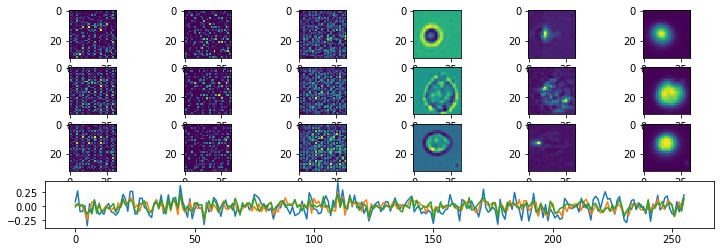

Epoch:  0 Iteration:  500 Loss:  8.53859 7.539603 0.9989876


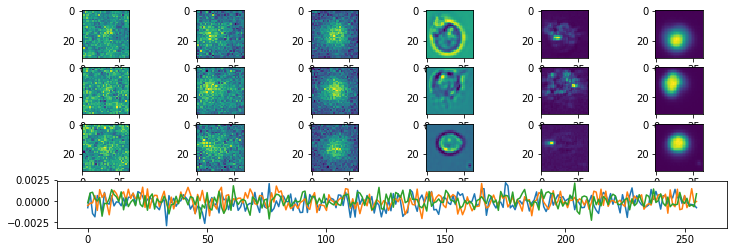

Epoch:  0 Iteration:  1000 Loss:  7.8713303 7.264674 0.6066559


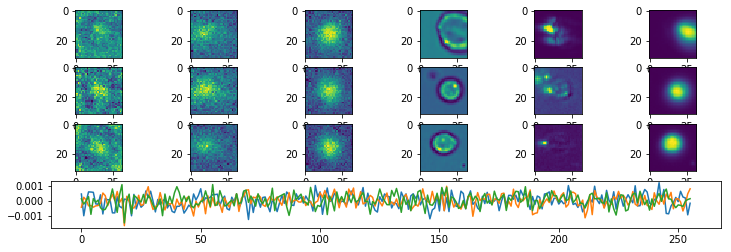

Epoch:  1 Iteration:  0 Loss:  7.1862445 6.641341 0.54490316


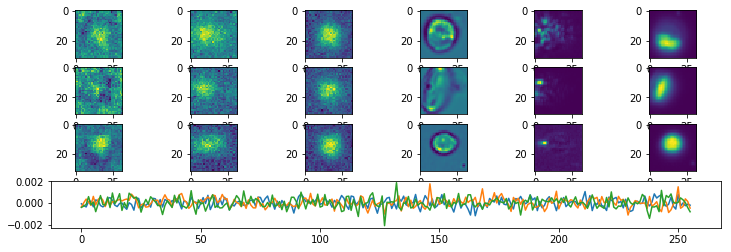

Epoch:  1 Iteration:  500 Loss:  88.796906 20.967134 67.82977


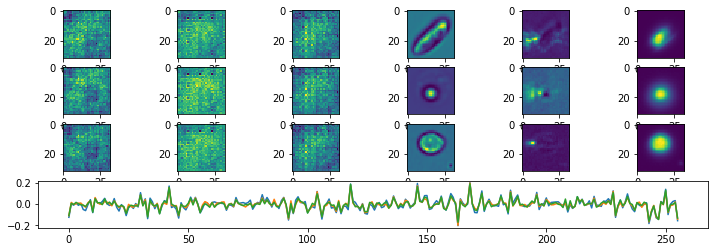

Epoch:  1 Iteration:  1000 Loss:  8.352205 6.9387197 1.4134855


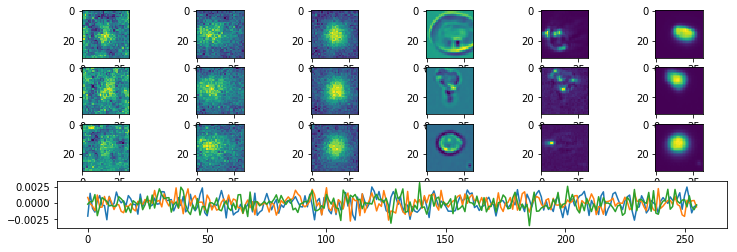

Epoch:  2 Iteration:  0 Loss:  7.755195 6.7513003 1.0038947


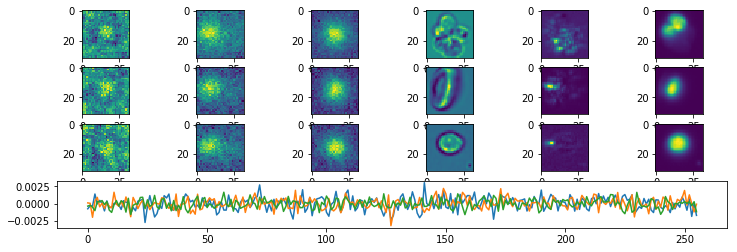

Epoch:  2 Iteration:  500 Loss:  7.4501595 6.7222953 0.7278641


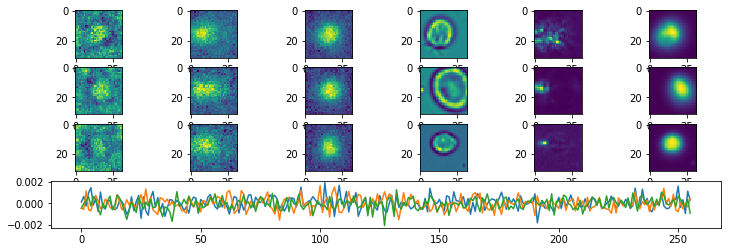

Epoch:  2 Iteration:  1000 Loss:  7.2497506 6.5798893 0.66986144


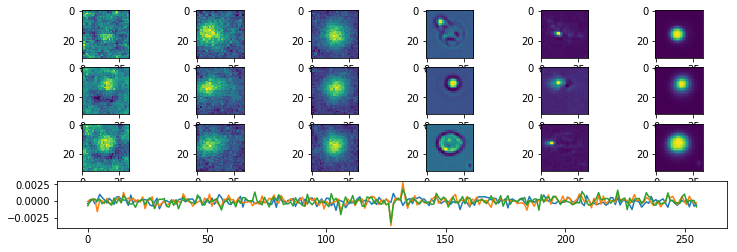

Epoch:  3 Iteration:  0 Loss:  6.908996 6.2776604 0.63133585


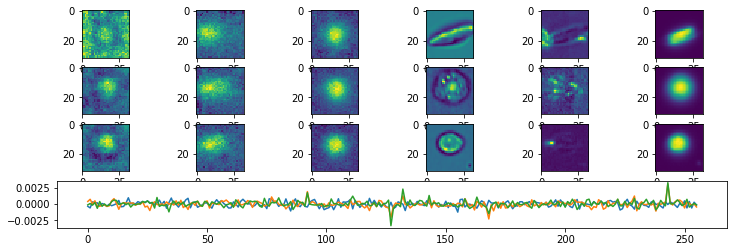

Epoch:  3 Iteration:  500 Loss:  6.8587728 6.2777243 0.5810485


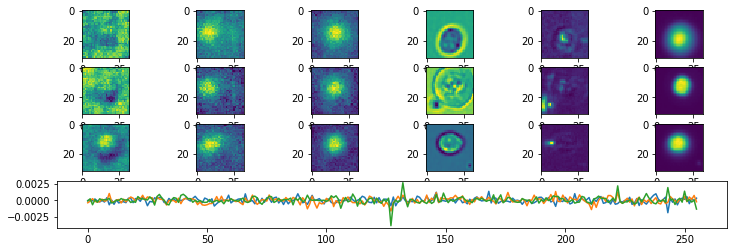

Epoch:  3 Iteration:  1000 Loss:  6.6976643 6.1385727 0.5590914


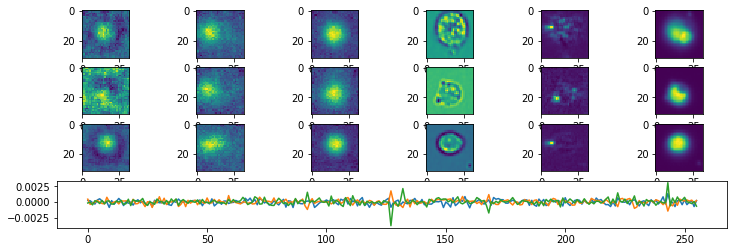

Epoch:  4 Iteration:  0 Loss:  6.4500823 5.9411197 0.50896245


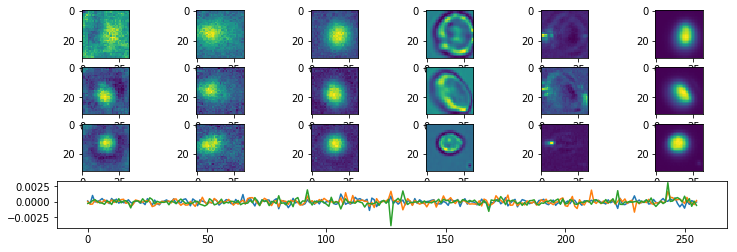

Epoch:  4 Iteration:  500 Loss:  6.3457947 5.8519983 0.49379644


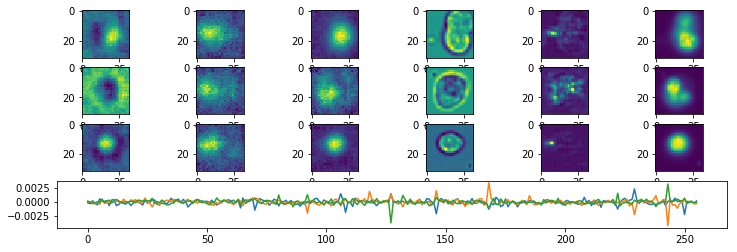

Epoch:  4 Iteration:  1000 Loss:  6.237176 5.734723 0.5024527


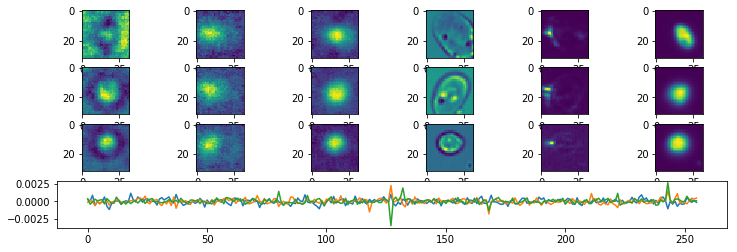

Epoch:  5 Iteration:  0 Loss:  5.9437885 5.386223 0.5575656


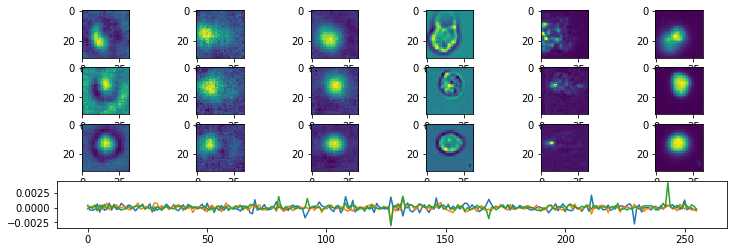

Epoch:  5 Iteration:  500 Loss:  7.4917555 6.2789536 1.212802


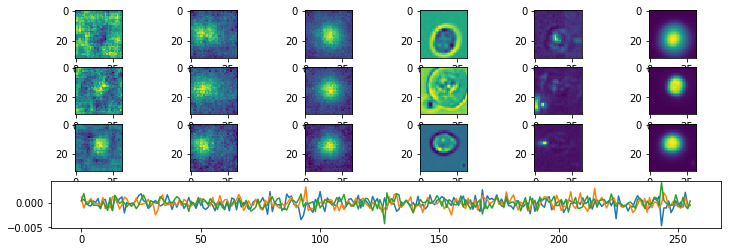

Epoch:  5 Iteration:  1000 Loss:  6.66394 5.664957 0.99898285


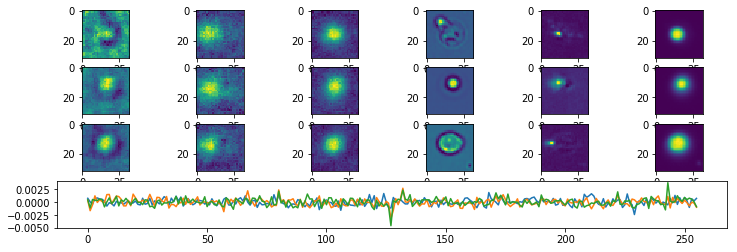

Epoch:  6 Iteration:  0 Loss:  6.2494793 5.350821 0.8986581


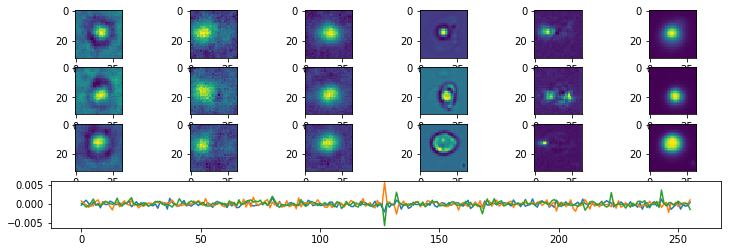

Epoch:  6 Iteration:  500 Loss:  6.0694475 5.283766 0.7856817


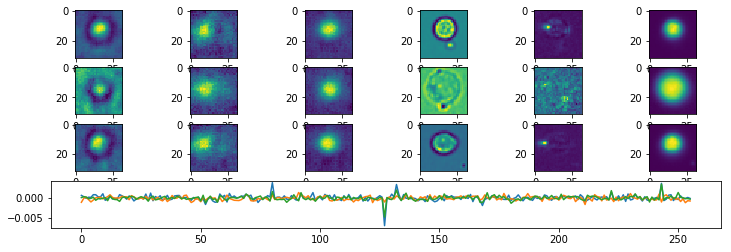

Epoch:  6 Iteration:  1000 Loss:  5.8323307 5.114011 0.7183197


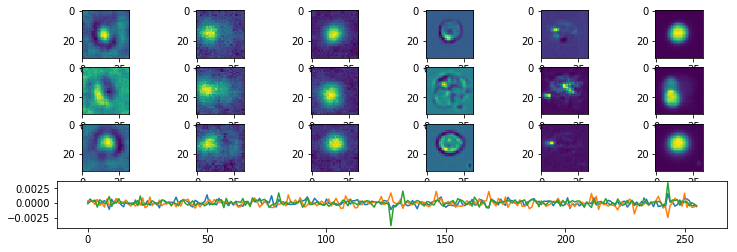

Epoch:  7 Iteration:  0 Loss:  5.5217004 4.806184 0.71551645


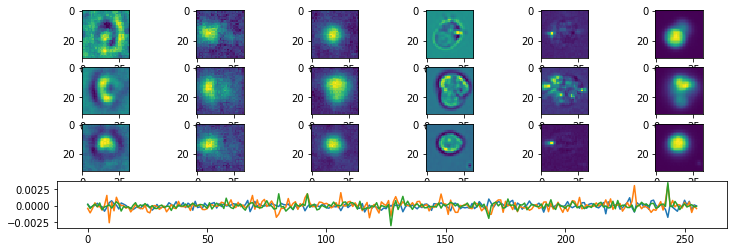

Epoch:  7 Iteration:  500 Loss:  5.312808 4.649053 0.6637547


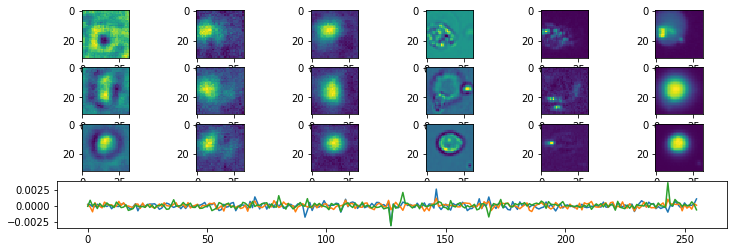

Epoch:  7 Iteration:  1000 Loss:  5.214676 4.533738 0.6809375


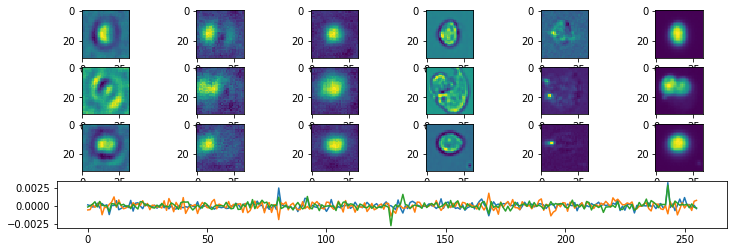

Epoch:  8 Iteration:  0 Loss:  4.7057066 4.03821 0.66749644


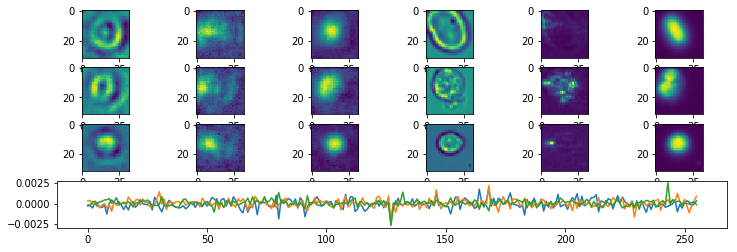

Epoch:  8 Iteration:  500 Loss:  6.710606 5.21685 1.4937563


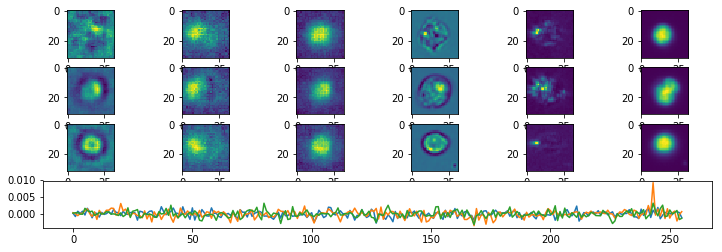

Epoch:  8 Iteration:  1000 Loss:  5.486262 4.3724985 1.1137632


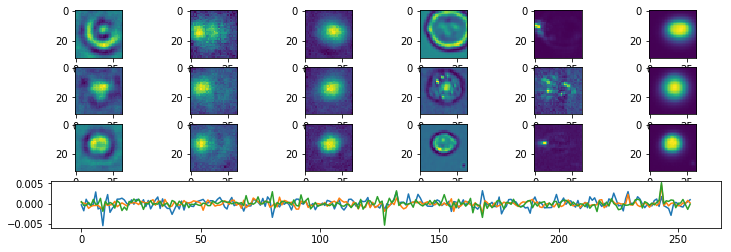

Epoch:  9 Iteration:  0 Loss:  4.937506 3.942124 0.99538213


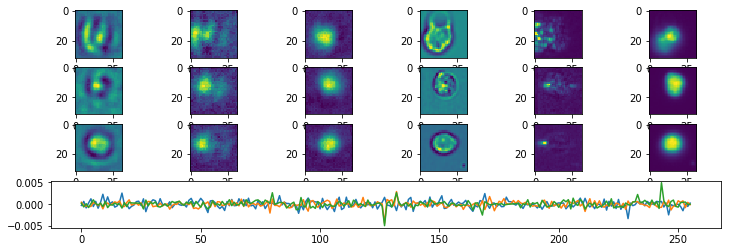

Epoch:  9 Iteration:  500 Loss:  4.8670926 3.9877124 0.8793802


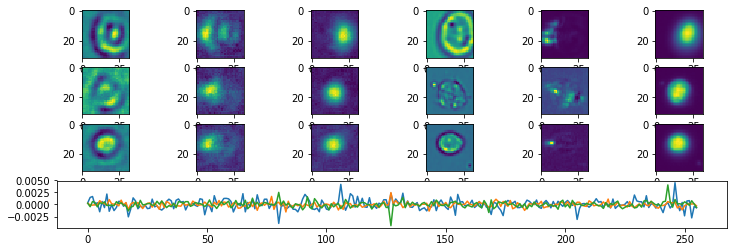

Epoch:  9 Iteration:  1000 Loss:  4.867119 3.9969373 0.8701815


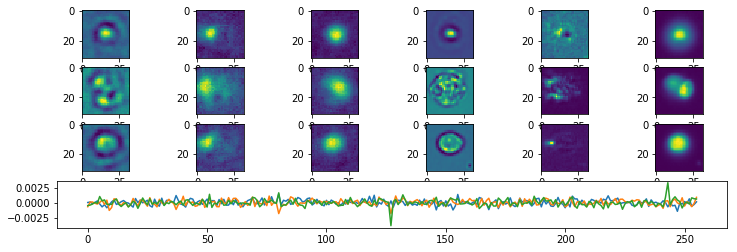

Epoch:  10 Iteration:  0 Loss:  6.628161 5.153518 1.4746429


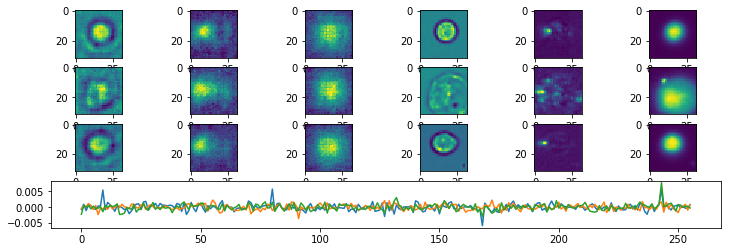

Epoch:  10 Iteration:  500 Loss:  5.380861 4.4003496 0.9805111


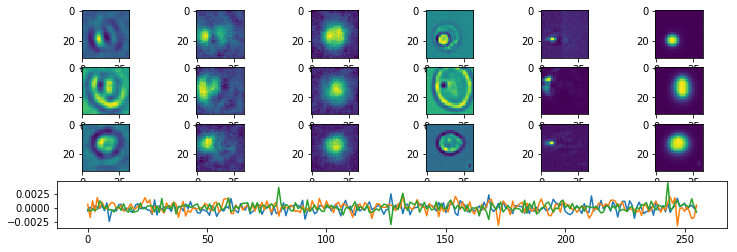

Epoch:  10 Iteration:  1000 Loss:  4.8521056 3.9499354 0.9021701


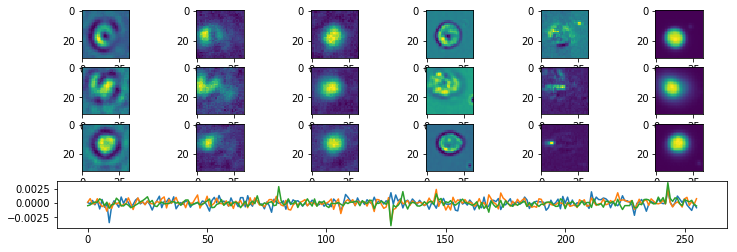

Epoch:  11 Iteration:  0 Loss:  4.345397 3.5279999 0.8173973


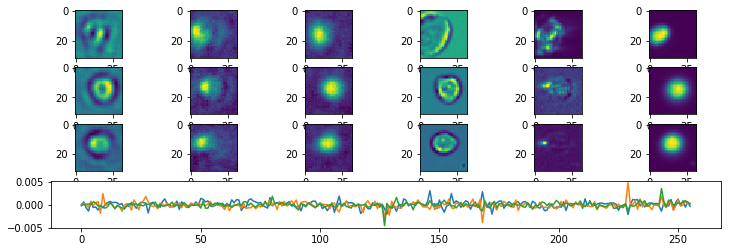

Epoch:  11 Iteration:  500 Loss:  4.275228 3.4891233 0.7861048


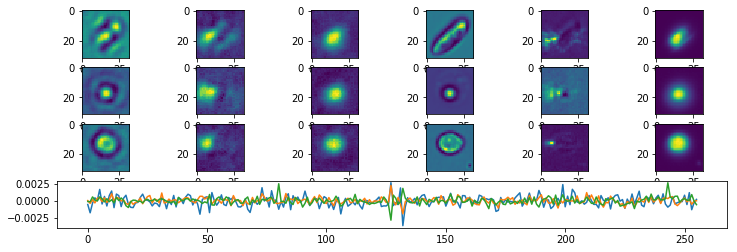

Epoch:  11 Iteration:  1000 Loss:  4.274452 3.4954543 0.77899784


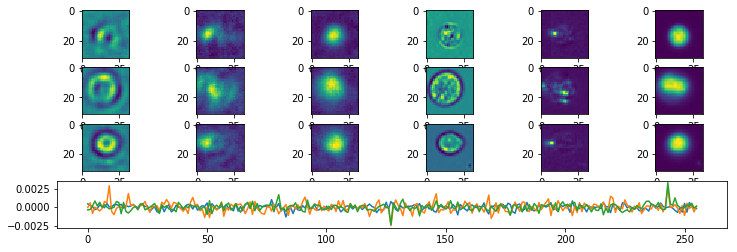

Epoch:  12 Iteration:  0 Loss:  3.9518728 3.214624 0.7372489


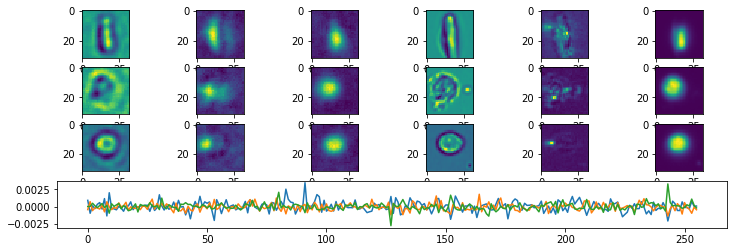

Epoch:  12 Iteration:  500 Loss:  6.4458556 4.630346 1.8155097


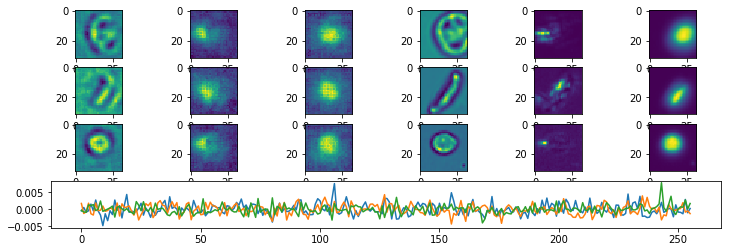

Epoch:  12 Iteration:  1000 Loss:  4.64256 3.4939334 1.1486267


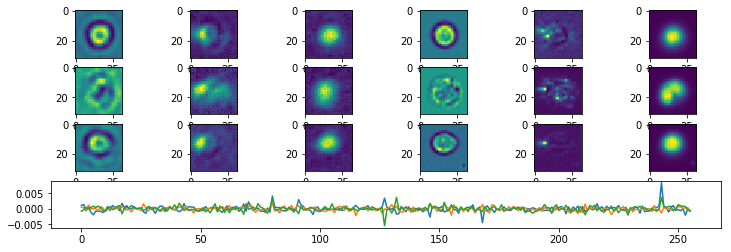

Epoch:  13 Iteration:  0 Loss:  4.125661 3.1251454 1.0005153


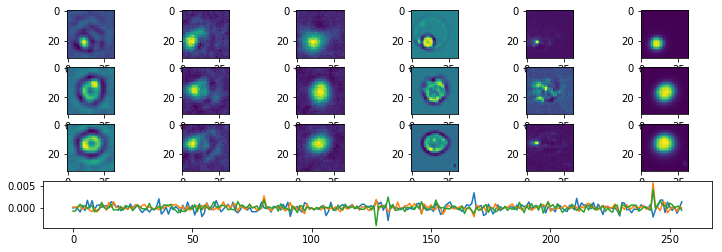

Epoch:  13 Iteration:  500 Loss:  4.0450687 3.1573787 0.88769007


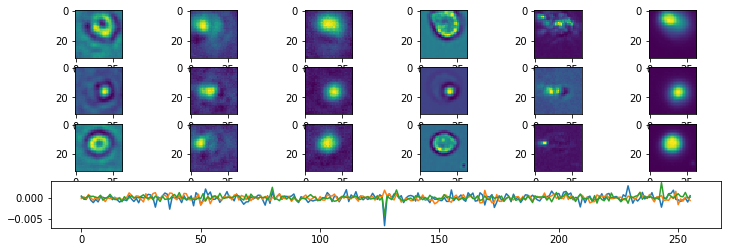

Epoch:  13 Iteration:  1000 Loss:  4.154348 3.310726 0.843622


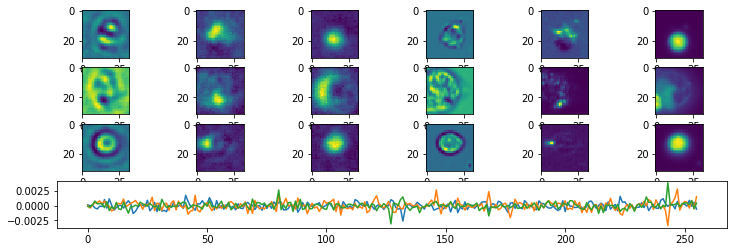

Epoch:  14 Iteration:  0 Loss:  3.8906221 3.097474 0.7931479


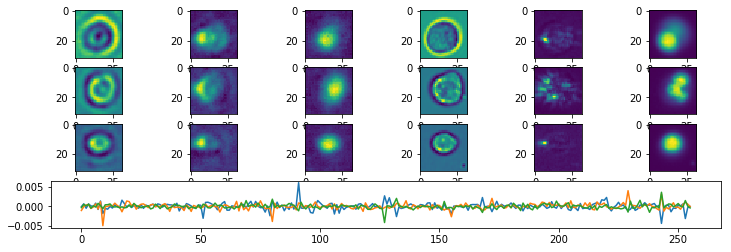

Epoch:  14 Iteration:  500 Loss:  3.634701 2.893075 0.7416261


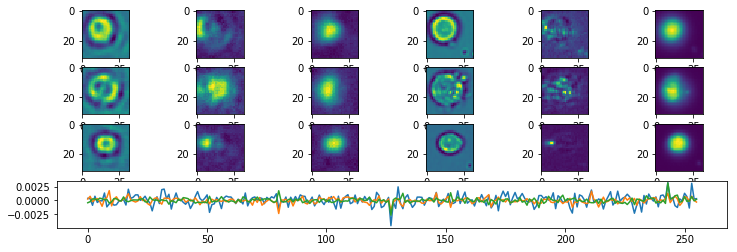

Epoch:  14 Iteration:  1000 Loss:  3.7387664 3.0274754 0.711291


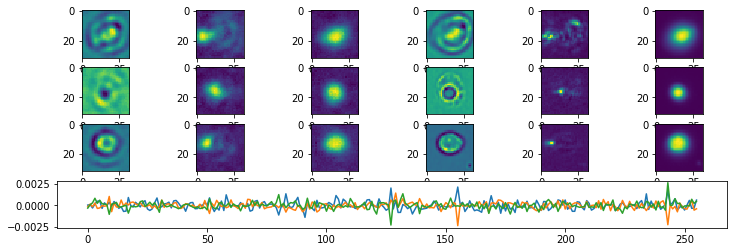

Epoch:  15 Iteration:  0 Loss:  5.988325 3.8325102 2.1558146


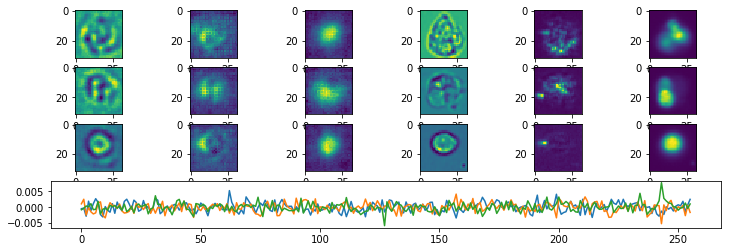

Epoch:  15 Iteration:  500 Loss:  4.135439 3.0137846 1.1216545


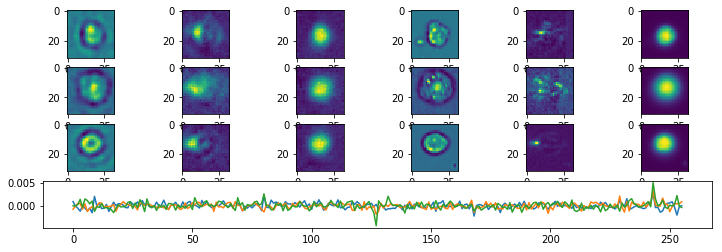

Epoch:  15 Iteration:  1000 Loss:  4.119774 3.1275644 0.99220943


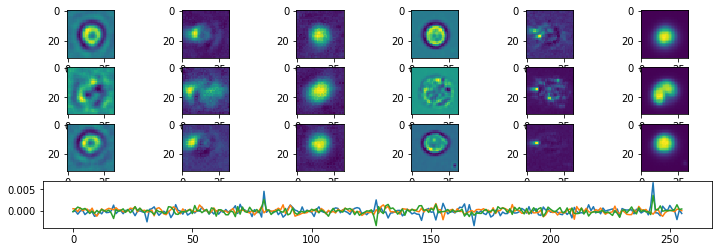

Epoch:  16 Iteration:  0 Loss:  3.62773 2.7847157 0.84301436


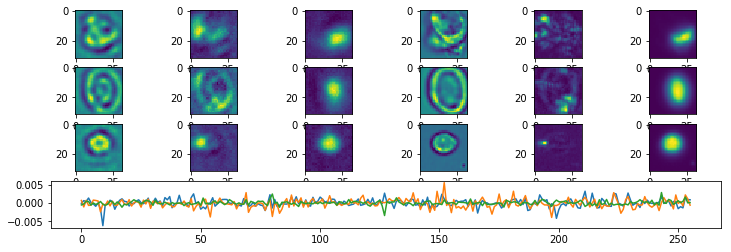

Epoch:  16 Iteration:  500 Loss:  3.5052464 2.7122364 0.79301


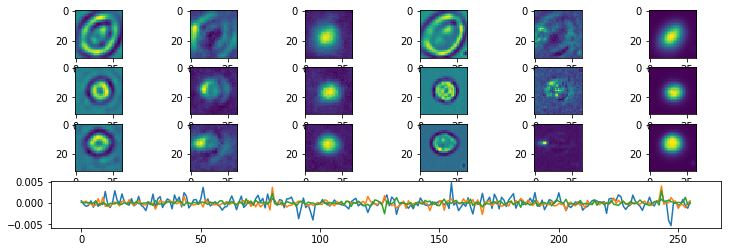

Epoch:  16 Iteration:  1000 Loss:  3.5868 2.8221 0.7647003


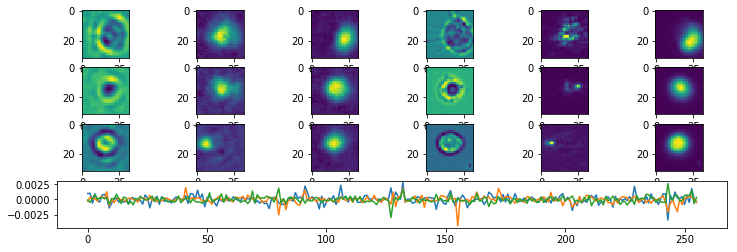

Epoch:  17 Iteration:  0 Loss:  3.2913089 2.5996022 0.6917066


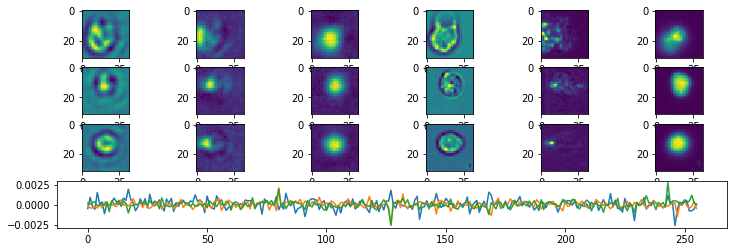

Epoch:  17 Iteration:  500 Loss:  3.248064 2.550311 0.697753


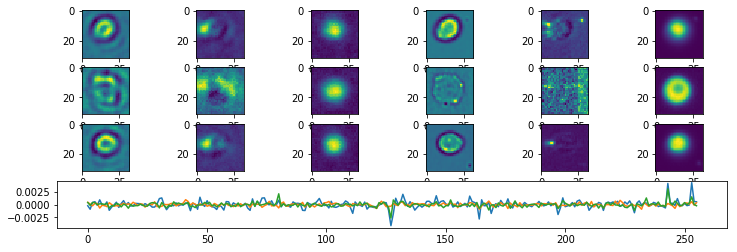

Epoch:  17 Iteration:  1000 Loss:  8.025806 6.1499186 1.8758878


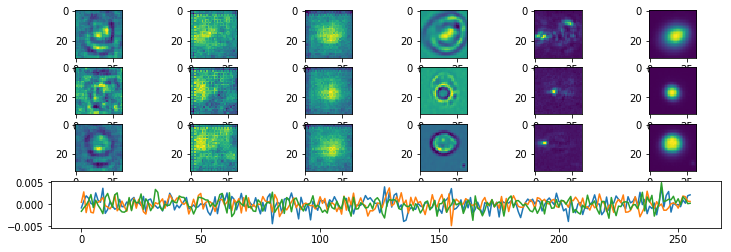

Epoch:  18 Iteration:  0 Loss:  4.425555 3.110674 1.3148811


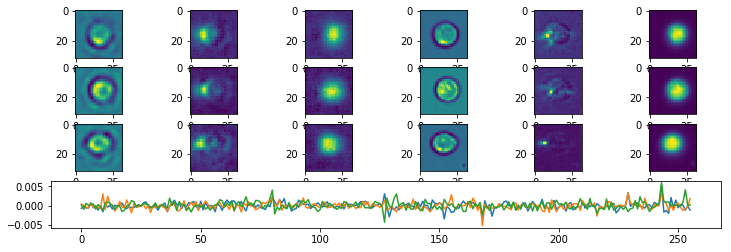

Epoch:  18 Iteration:  500 Loss:  3.7048428 2.674489 1.0303538


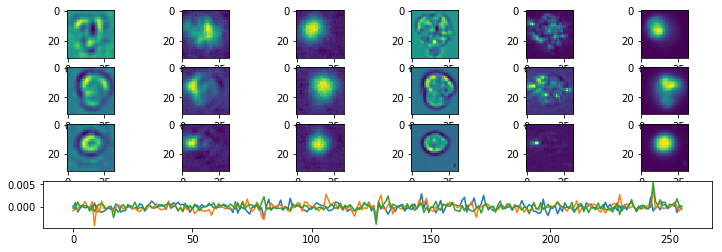

Epoch:  18 Iteration:  1000 Loss:  3.6614633 2.725804 0.9356592


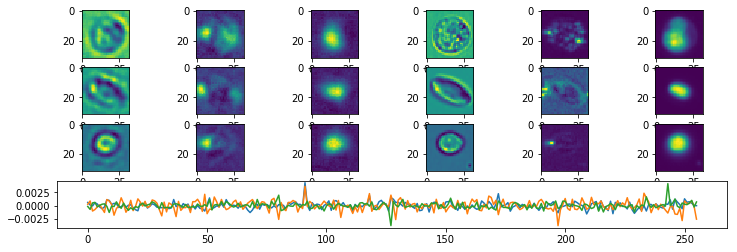

Epoch:  19 Iteration:  0 Loss:  3.3903112 2.5509067 0.8394047


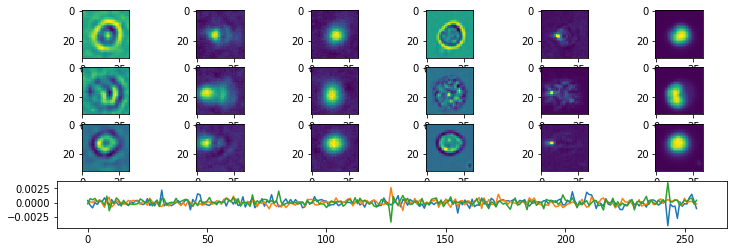

Epoch:  19 Iteration:  500 Loss:  3.3585424 2.5744781 0.78406423


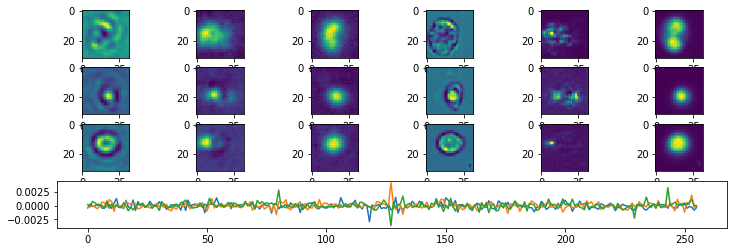

Epoch:  19 Iteration:  1000 Loss:  3.3879676 2.6052308 0.7827368


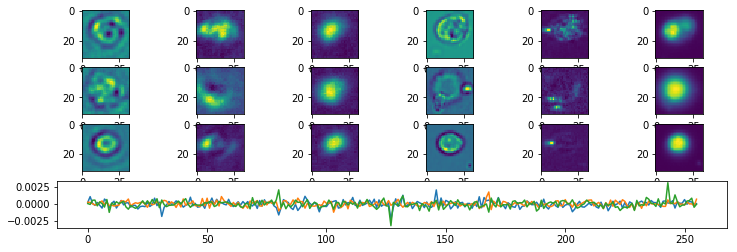

Epoch:  20 Iteration:  0 Loss:  3.069904 2.391757 0.678147


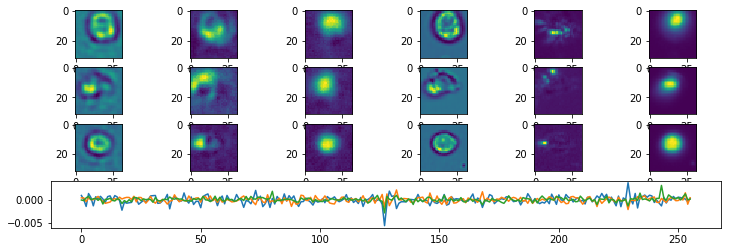

Epoch:  20 Iteration:  500 Loss:  3.0678504 2.3502069 0.71764344


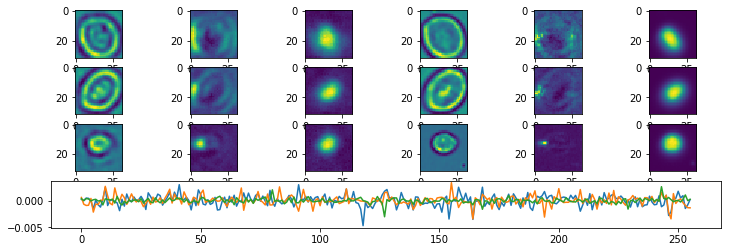

Epoch:  20 Iteration:  1000 Loss:  4.443246 2.9983845 1.4448617


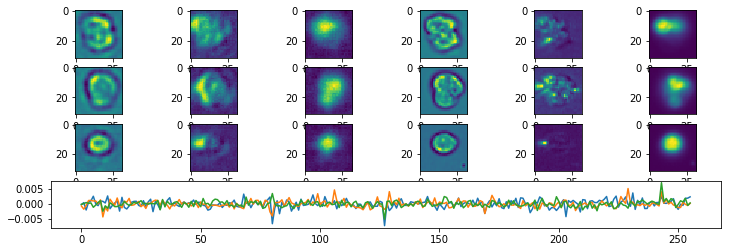

Epoch:  21 Iteration:  0 Loss:  3.7443914 2.5930295 1.151362


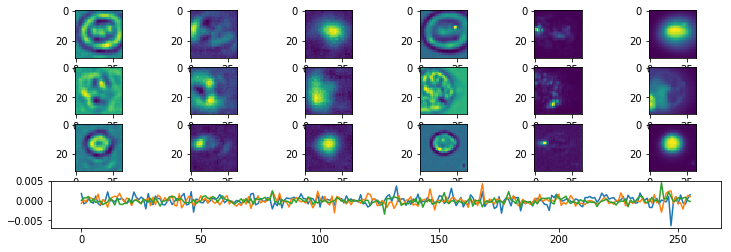

Epoch:  21 Iteration:  500 Loss:  3.3997526 2.436562 0.96319056


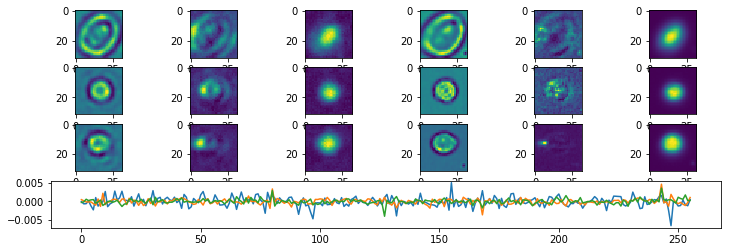

Epoch:  21 Iteration:  1000 Loss:  3.5173411 2.6415286 0.87581253


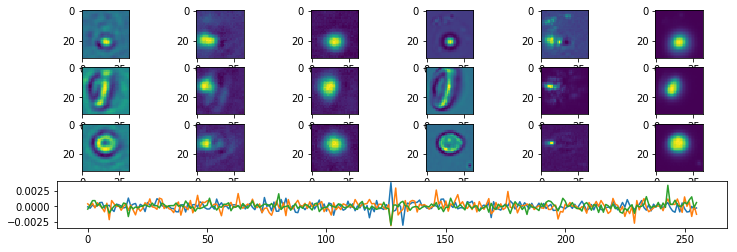

Epoch:  22 Iteration:  0 Loss:  3.1252072 2.33508 0.7901272


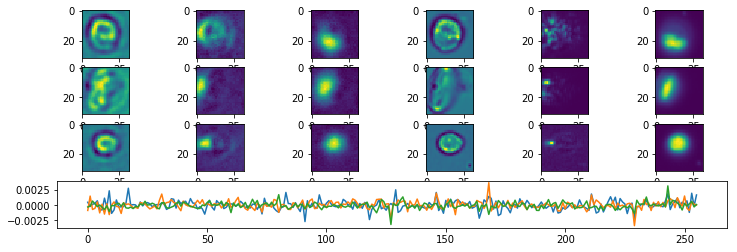

Epoch:  22 Iteration:  500 Loss:  3.1066387 2.334093 0.7725455


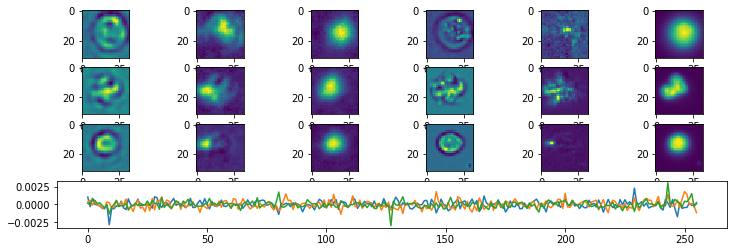

Epoch:  22 Iteration:  1000 Loss:  3.183785 2.4677653 0.71601975


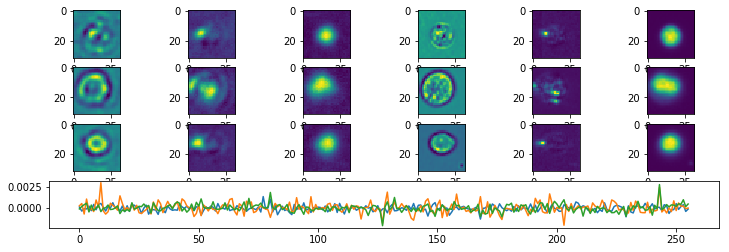

Epoch:  23 Iteration:  0 Loss:  2.9848535 2.2765126 0.7083408


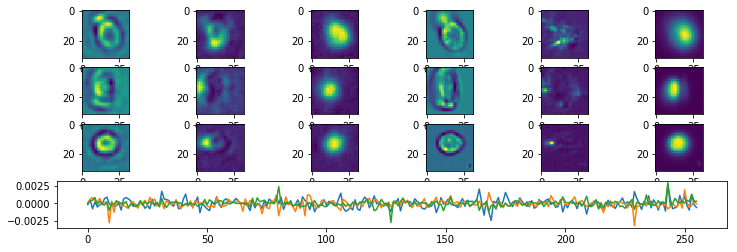

Epoch:  23 Iteration:  500 Loss:  2.8607452 2.2068367 0.65390843


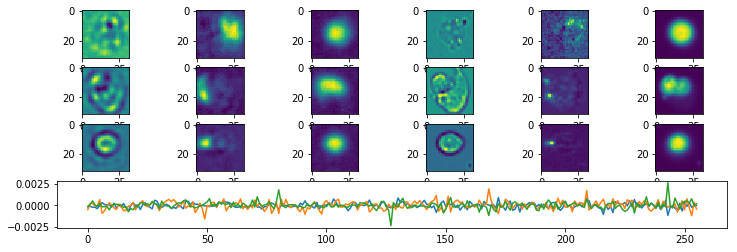

Epoch:  23 Iteration:  1000 Loss:  3.024737 2.3610024 0.6637344


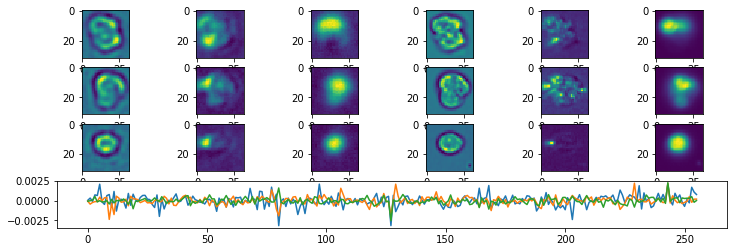

Epoch:  24 Iteration:  0 Loss:  2.7694464 2.1249595 0.64448684


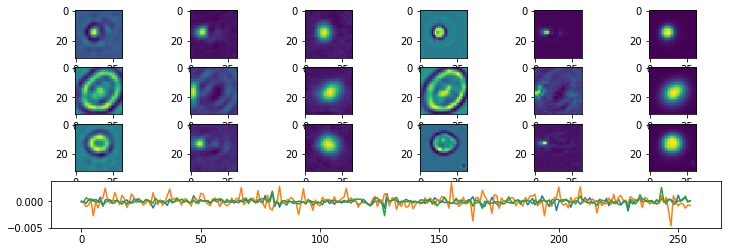

Epoch:  24 Iteration:  500 Loss:  8.268178 6.776307 1.491871


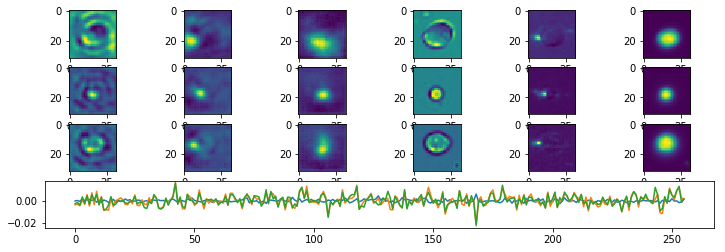

Epoch:  24 Iteration:  1000 Loss:  3.6983762 2.4941375 1.2042388


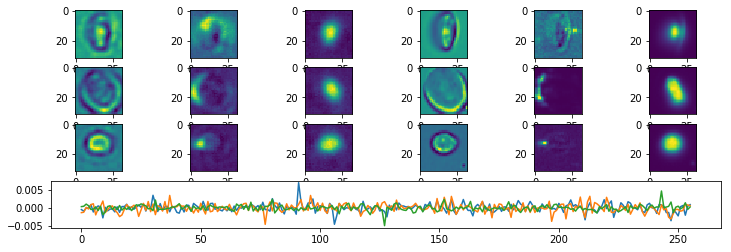

Epoch:  25 Iteration:  0 Loss:  3.071036 2.1962202 0.87481594


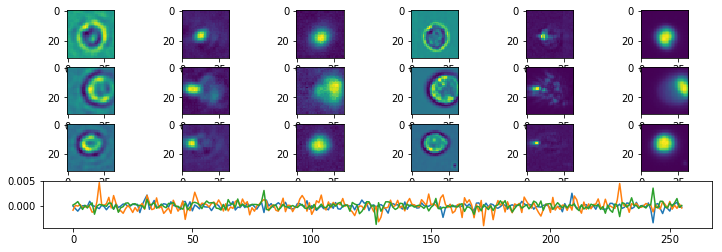

Epoch:  25 Iteration:  500 Loss:  2.9179683 2.128168 0.7898001


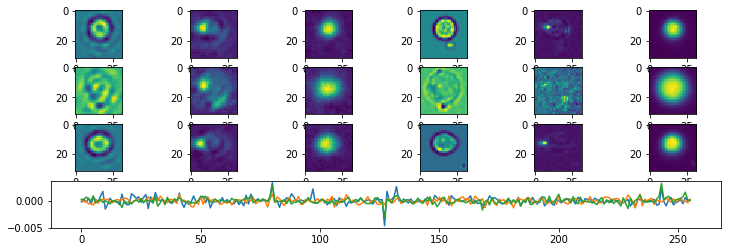

Epoch:  25 Iteration:  1000 Loss:  2.9436846 2.2126565 0.7310281


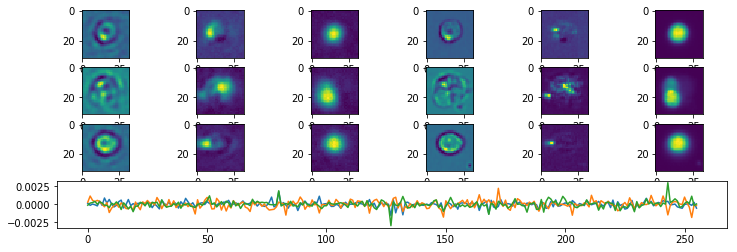

Epoch:  26 Iteration:  0 Loss:  2.7490187 2.0793197 0.6696989


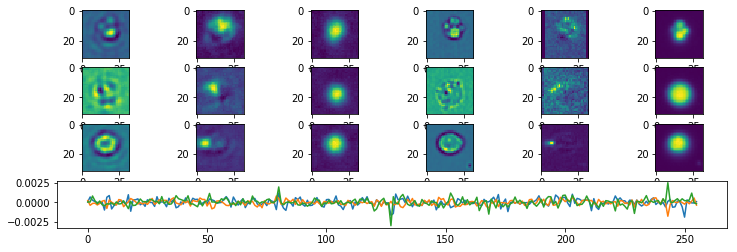

Epoch:  26 Iteration:  500 Loss:  2.8197532 2.1018815 0.7178717


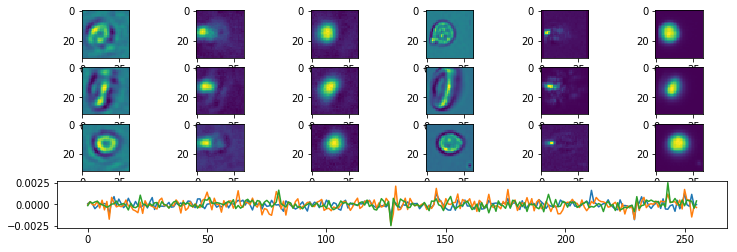

Epoch:  26 Iteration:  1000 Loss:  3.3533373 2.3183026 1.0350348


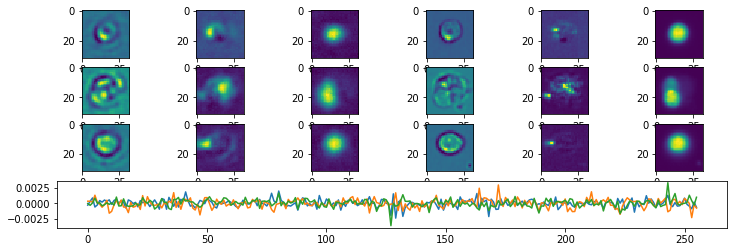

Epoch:  27 Iteration:  0 Loss:  2.8430698 2.0564504 0.78661937


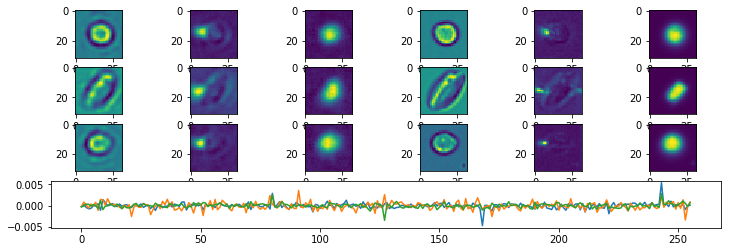

Epoch:  27 Iteration:  500 Loss:  2.7648256 2.0215952 0.7432303


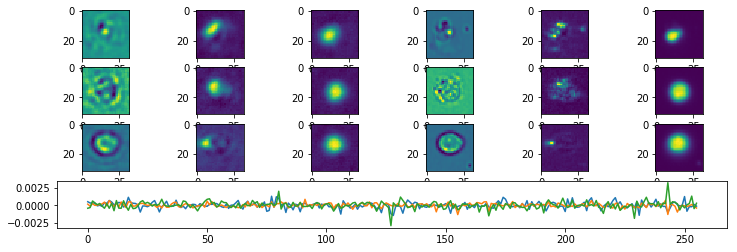

Epoch:  27 Iteration:  1000 Loss:  2.8485148 2.1645033 0.6840114


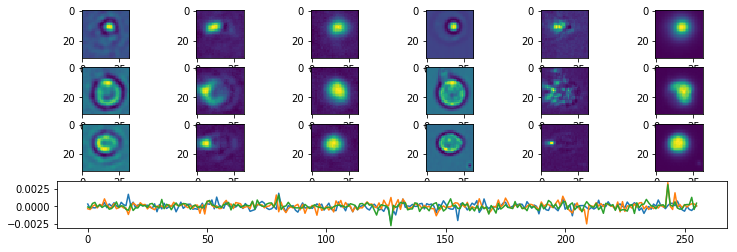

Epoch:  28 Iteration:  0 Loss:  2.5586913 1.9197959 0.63889533


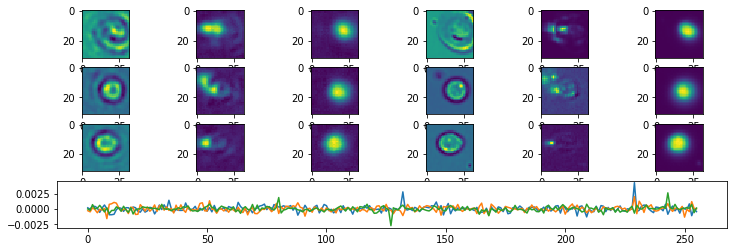

Epoch:  28 Iteration:  500 Loss:  2.6888149 2.008592 0.6802229


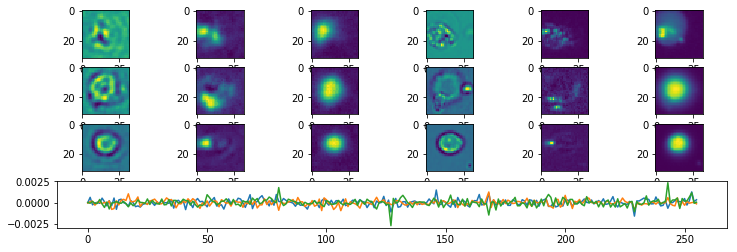

Epoch:  28 Iteration:  1000 Loss:  2.6854525 2.0724742 0.61297816


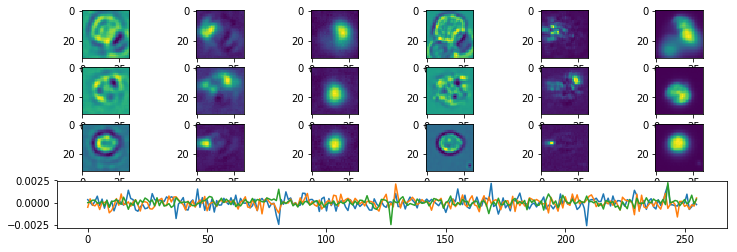

Epoch:  29 Iteration:  0 Loss:  3.9496412 2.4370506 1.5125908


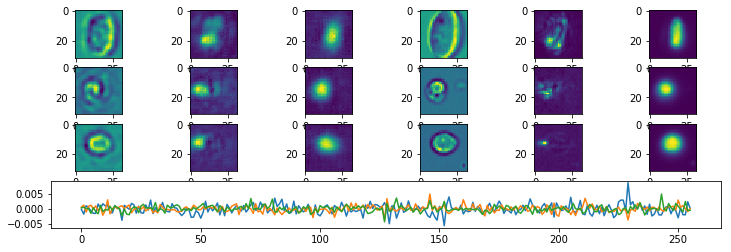

Epoch:  29 Iteration:  500 Loss:  3.434753 2.2648404 1.1699127


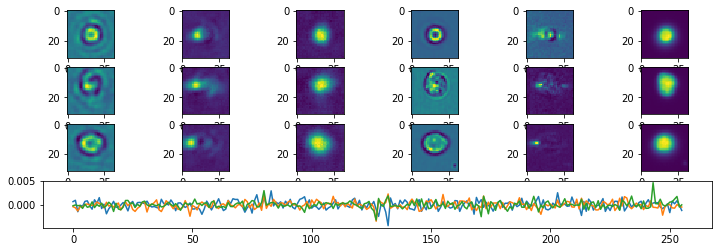

Epoch:  29 Iteration:  1000 Loss:  3.2538993 2.2726045 0.9812948


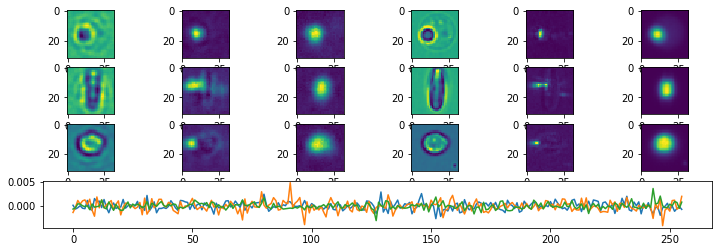

Epoch:  30 Iteration:  0 Loss:  2.8247077 2.0049329 0.8197748


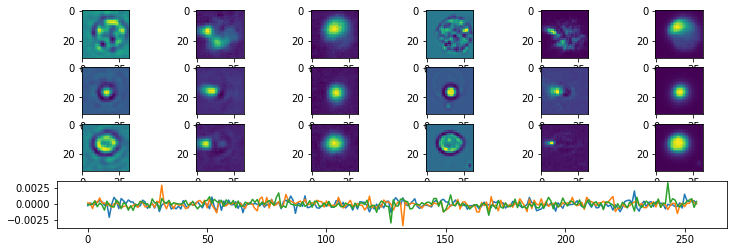

Epoch:  30 Iteration:  500 Loss:  2.7596576 1.9834582 0.77619946


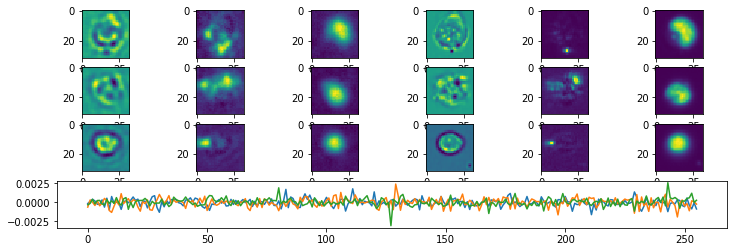

Epoch:  30 Iteration:  1000 Loss:  2.8084416 2.058362 0.7500796


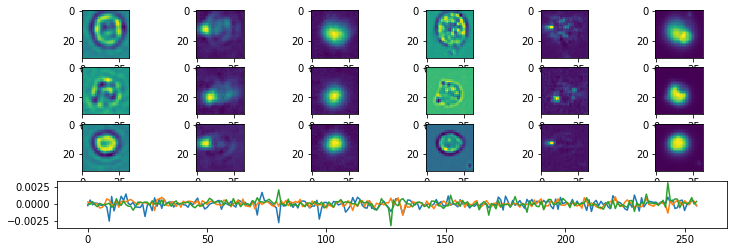

Epoch:  31 Iteration:  0 Loss:  2.556409 1.896198 0.66021097


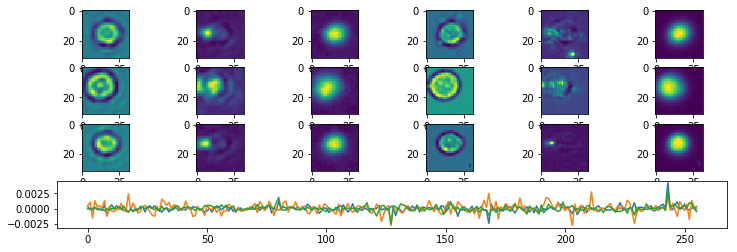

Epoch:  31 Iteration:  500 Loss:  2.764606 2.0040774 0.76052856


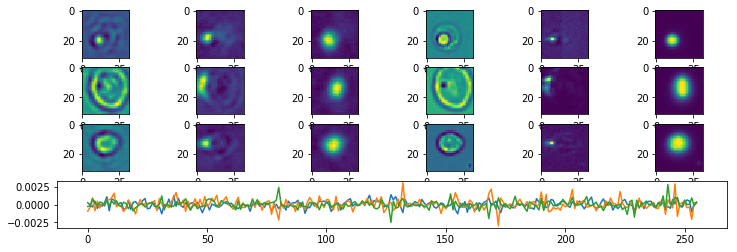

Epoch:  31 Iteration:  1000 Loss:  3.112948 2.29592 0.81702805


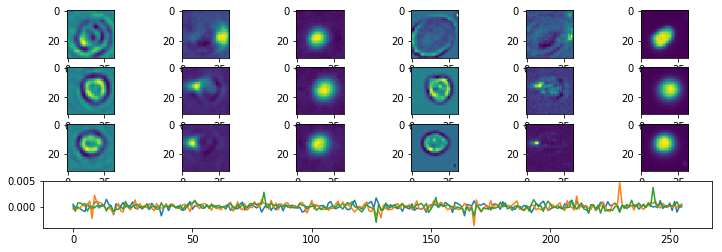

Epoch:  32 Iteration:  0 Loss:  2.3879821 1.7979326 0.59004945


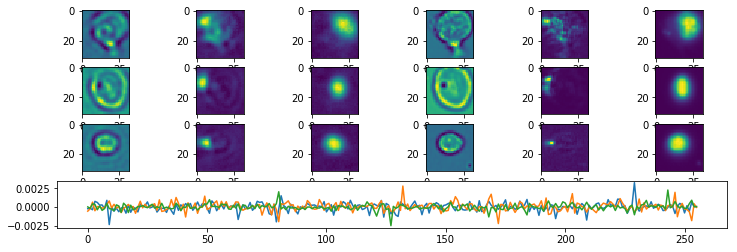

Epoch:  32 Iteration:  500 Loss:  2.370256 1.7923007 0.5779552


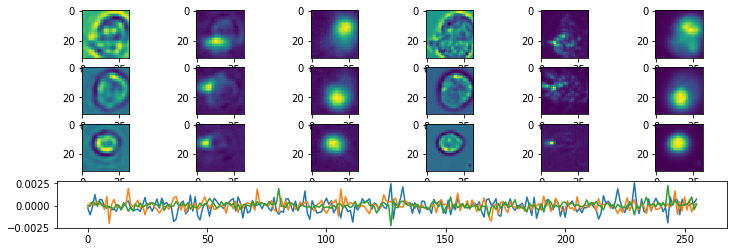

Epoch:  32 Iteration:  1000 Loss:  3.9304302 2.405841 1.5245891


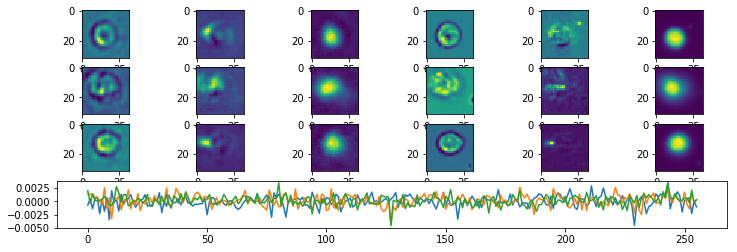

Epoch:  33 Iteration:  0 Loss:  2.9309745 1.9748714 0.95610297


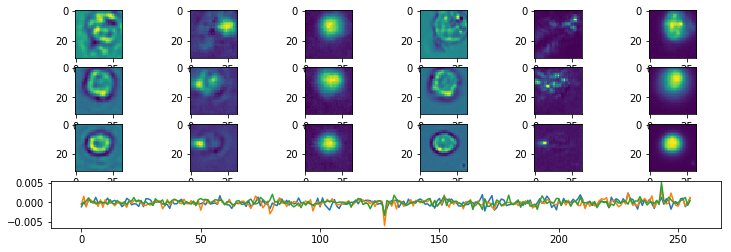

Epoch:  33 Iteration:  500 Loss:  2.6630192 1.8110243 0.8519948


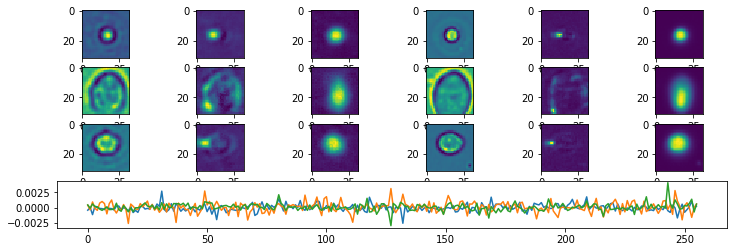

Epoch:  33 Iteration:  1000 Loss:  2.9229624 2.1183035 0.8046589


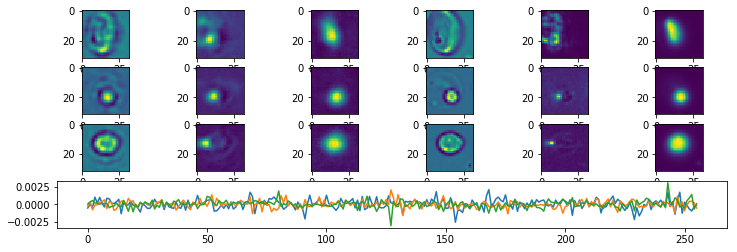

Epoch:  34 Iteration:  0 Loss:  2.4486933 1.7668693 0.6818241


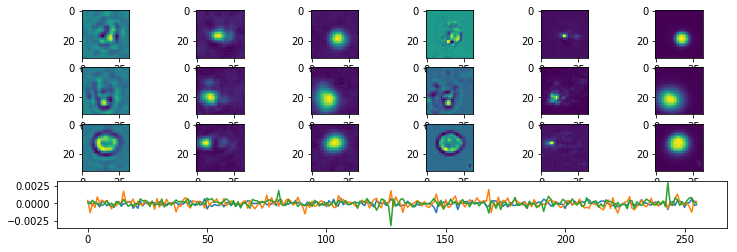

Epoch:  34 Iteration:  500 Loss:  2.8227258 2.1063762 0.7163495


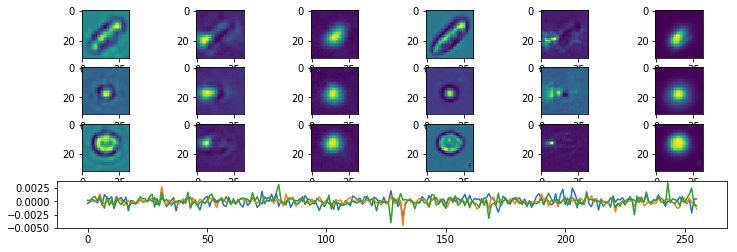

Epoch:  34 Iteration:  1000 Loss:  2.494125 1.8461151 0.6480099


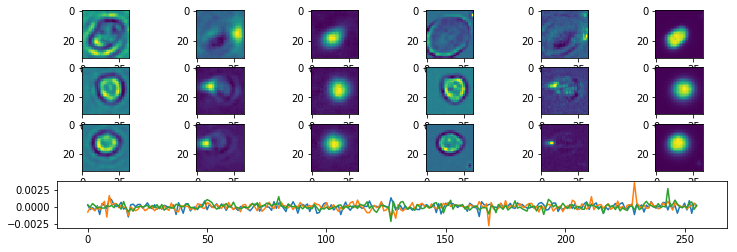

Epoch:  35 Iteration:  0 Loss:  2.366609 1.7511698 0.61543936


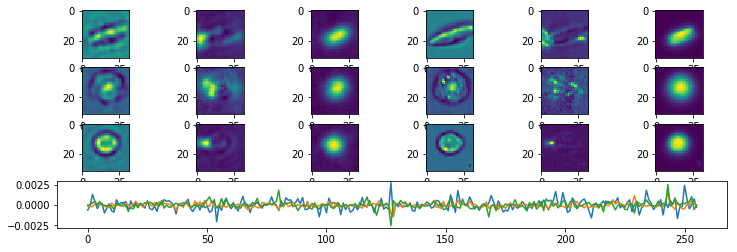

Epoch:  35 Iteration:  500 Loss:  2.3620315 1.7516165 0.6104151


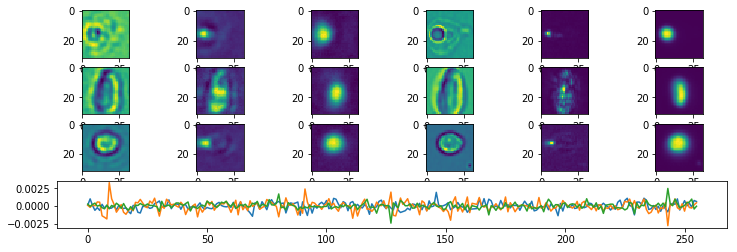

Epoch:  35 Iteration:  1000 Loss:  2.5033412 1.889201 0.6141402


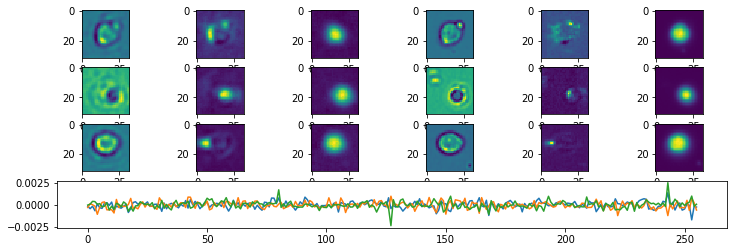

Epoch:  36 Iteration:  0 Loss:  2.239783 1.6493714 0.5904116


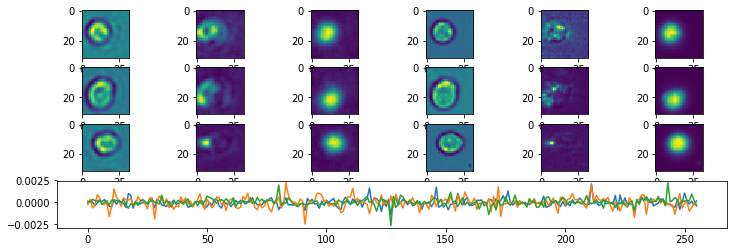

Epoch:  36 Iteration:  500 Loss:  4.3060694 2.513342 1.7927274


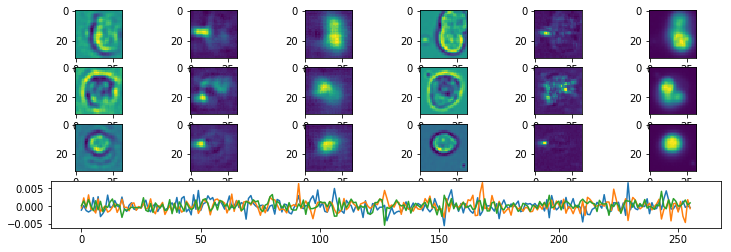

Epoch:  36 Iteration:  1000 Loss:  3.2521522 2.0877862 1.164366


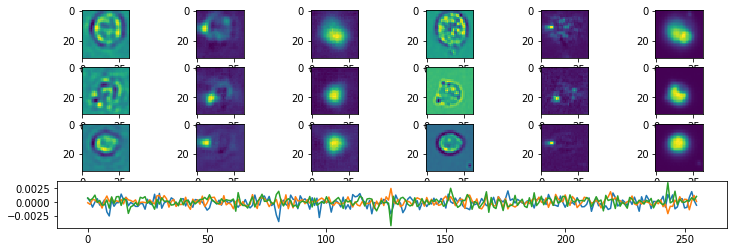

Epoch:  37 Iteration:  0 Loss:  2.717319 1.7490788 0.9682404


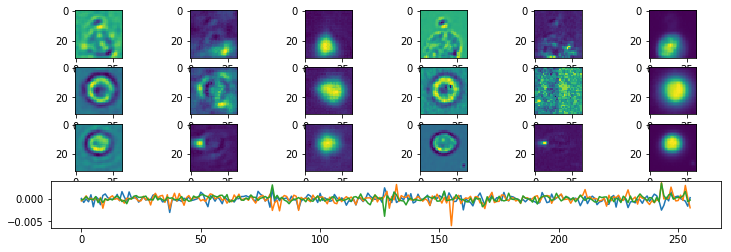

Epoch:  37 Iteration:  500 Loss:  2.6278245 1.7954156 0.8324089


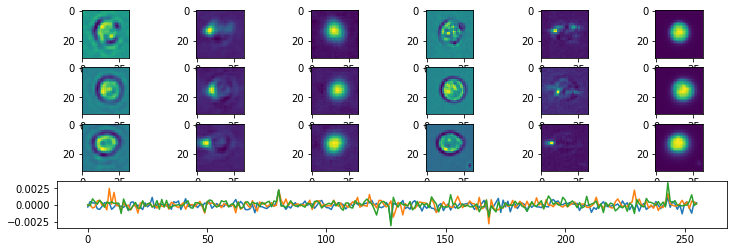

Epoch:  37 Iteration:  1000 Loss:  2.6397858 1.8973265 0.74245936


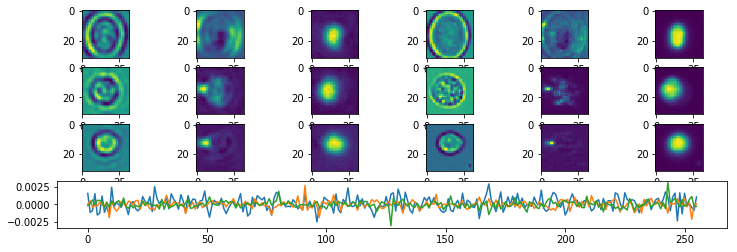

Epoch:  38 Iteration:  0 Loss:  2.3200393 1.6464701 0.6735692


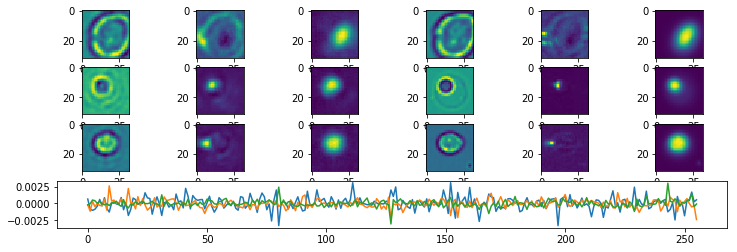

Epoch:  38 Iteration:  500 Loss:  2.283934 1.6535385 0.63039553


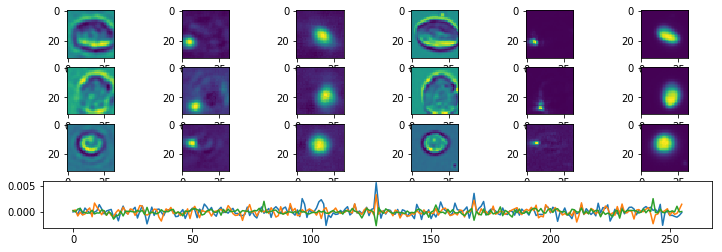

Epoch:  38 Iteration:  1000 Loss:  2.461461 1.8293483 0.6321128


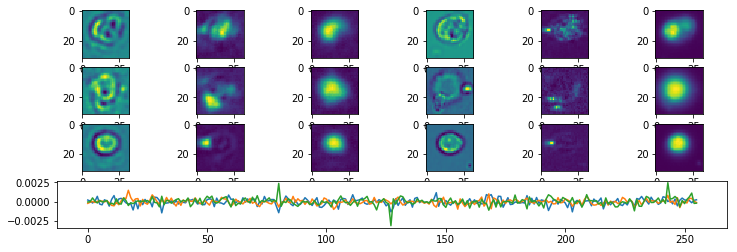

Epoch:  39 Iteration:  0 Loss:  2.1993341 1.6065819 0.59275216


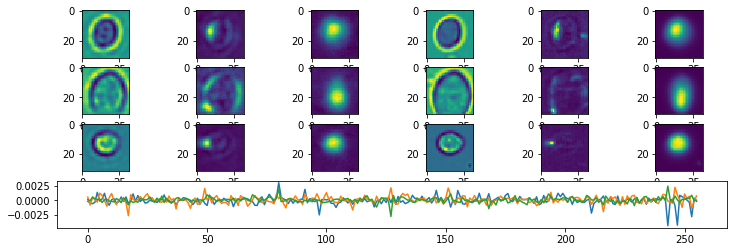

Epoch:  39 Iteration:  500 Loss:  12.735146 7.047303 5.687842


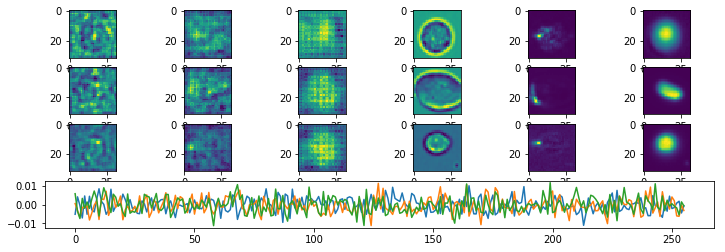

Epoch:  39 Iteration:  1000 Loss:  3.5537033 2.2100024 1.3437008


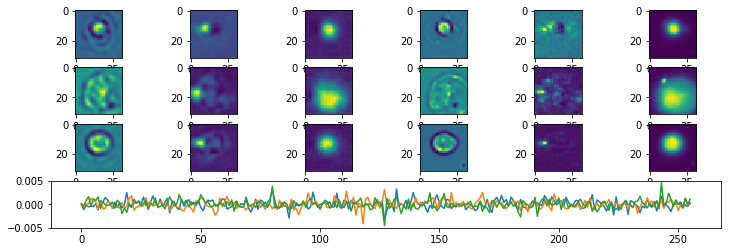

Epoch:  40 Iteration:  0 Loss:  2.7953749 1.7925327 1.0028422


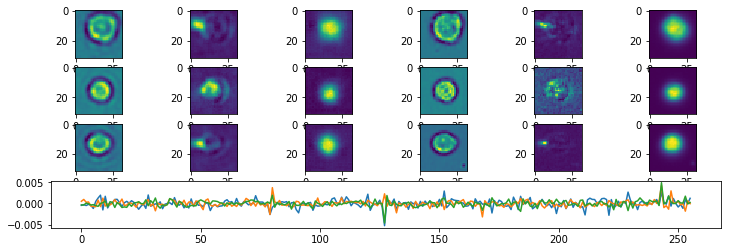

Epoch:  40 Iteration:  500 Loss:  2.6366022 1.7357026 0.9008995


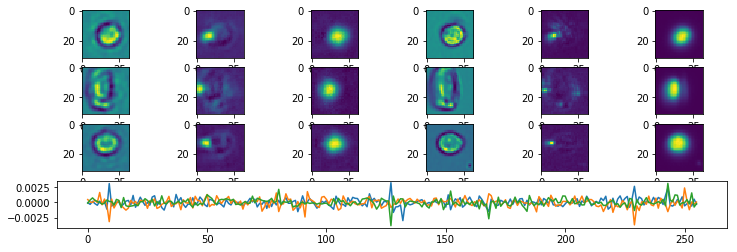

Epoch:  40 Iteration:  1000 Loss:  2.6065044 1.8092724 0.797232


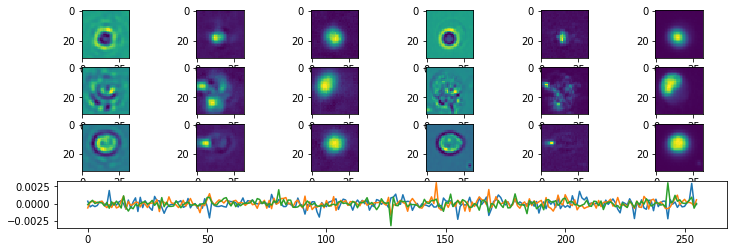

Epoch:  41 Iteration:  0 Loss:  2.3636103 1.6705683 0.693042


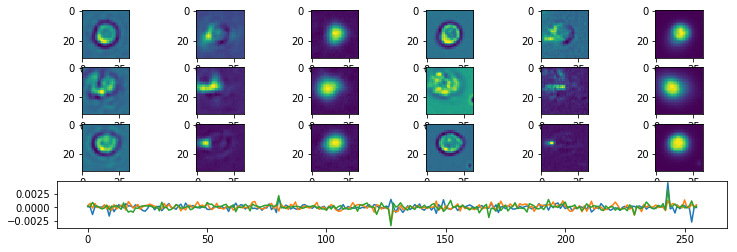

Epoch:  41 Iteration:  500 Loss:  2.2709231 1.6128495 0.65807366


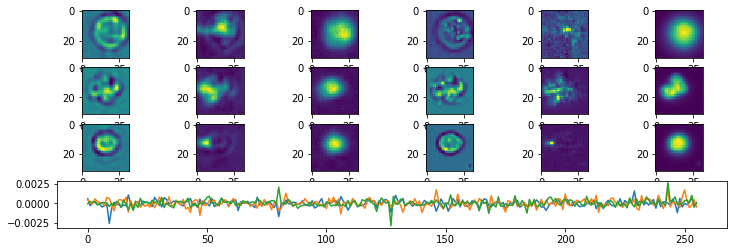

Epoch:  41 Iteration:  1000 Loss:  2.4344866 1.7713001 0.6631865


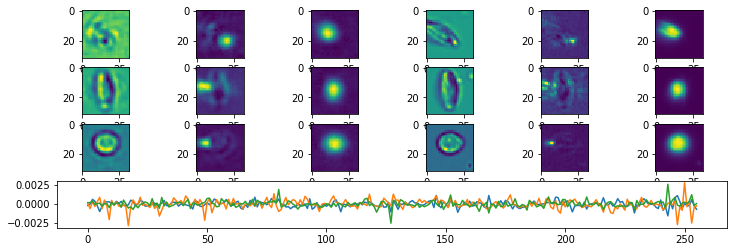

Epoch:  42 Iteration:  0 Loss:  2.265038 1.6490066 0.61603135


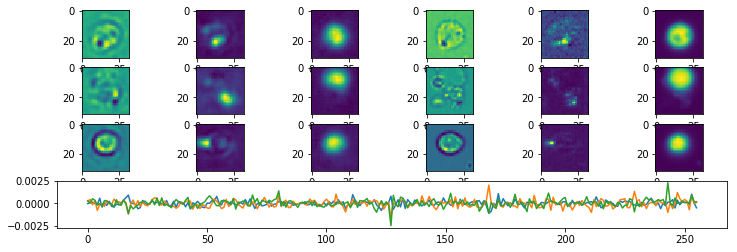

Epoch:  42 Iteration:  500 Loss:  2.1620722 1.5506947 0.61137736


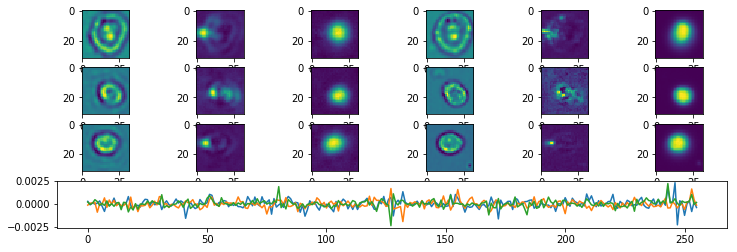

Epoch:  42 Iteration:  1000 Loss:  2.44835 1.8112326 0.63711727


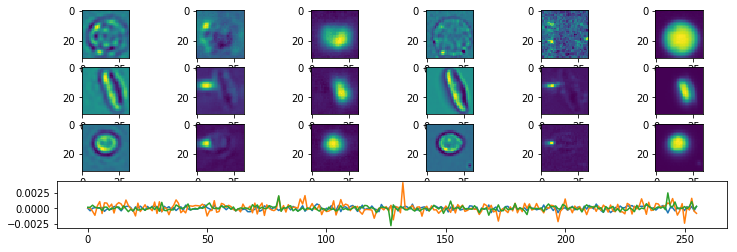

Epoch:  43 Iteration:  0 Loss:  8.396996 5.7171926 2.6798027


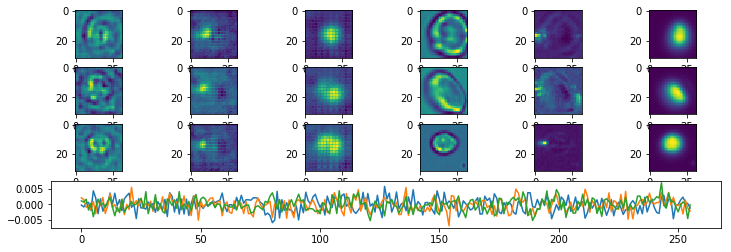

Epoch:  43 Iteration:  500 Loss:  2.776165 1.7497736 1.0263914


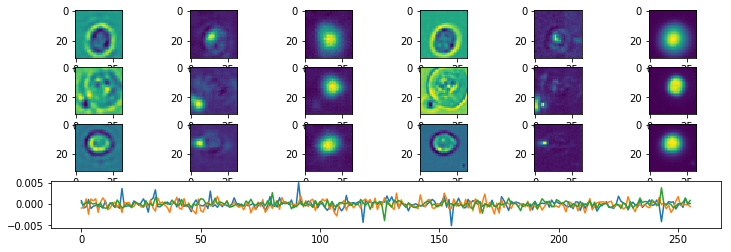

Epoch:  43 Iteration:  1000 Loss:  2.5673273 1.7608325 0.8064947


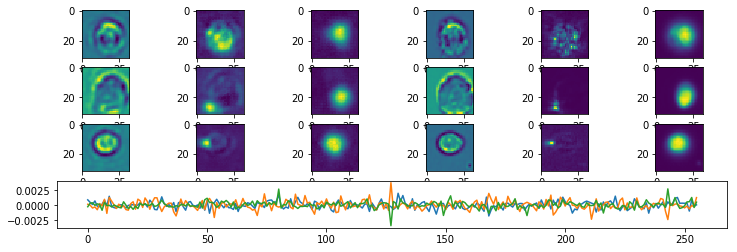

Epoch:  44 Iteration:  0 Loss:  2.3167439 1.6284481 0.6882957


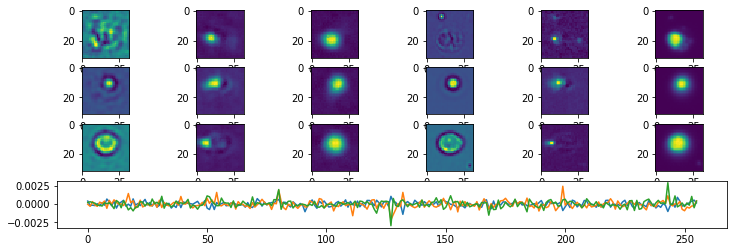

Epoch:  44 Iteration:  500 Loss:  2.2211773 1.568234 0.6529433


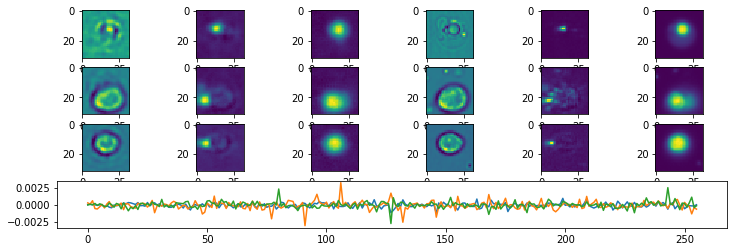

Epoch:  44 Iteration:  1000 Loss:  2.6579041 1.8642552 0.79364884


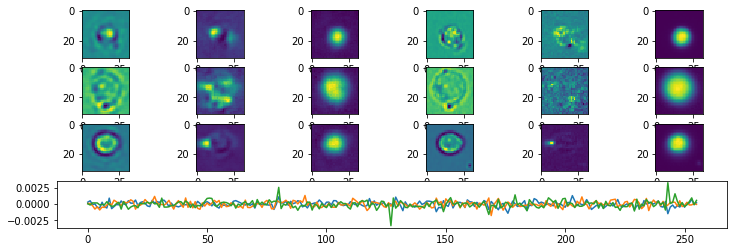

Epoch:  45 Iteration:  0 Loss:  2.108137 1.5064131 0.6017238


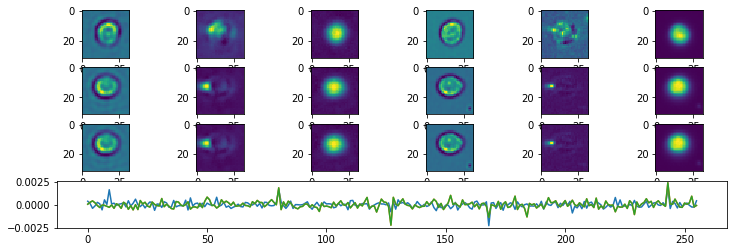

Epoch:  45 Iteration:  500 Loss:  2.1171844 1.5402746 0.57690984


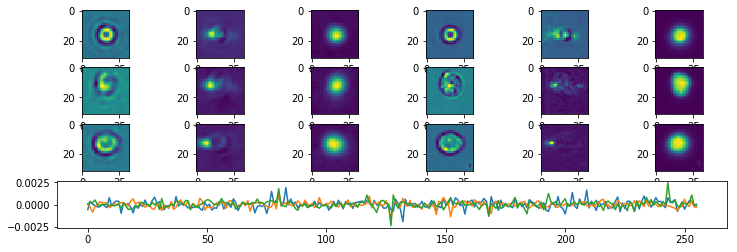

Epoch:  45 Iteration:  1000 Loss:  3.3604789 2.0487094 1.3117695


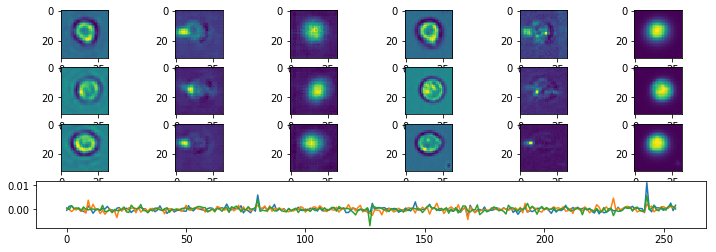

Epoch:  46 Iteration:  0 Loss:  2.6649501 1.6686482 0.99630195


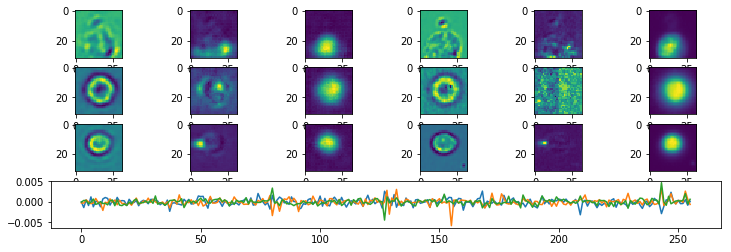

Epoch:  46 Iteration:  500 Loss:  2.3862321 1.5724868 0.8137453


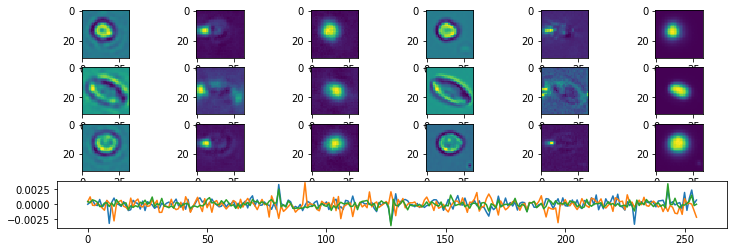

Epoch:  46 Iteration:  1000 Loss:  2.4114463 1.6795462 0.73190016


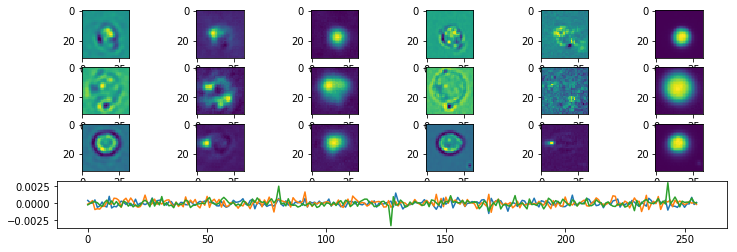

Epoch:  47 Iteration:  0 Loss:  2.1776855 1.5314451 0.6462404


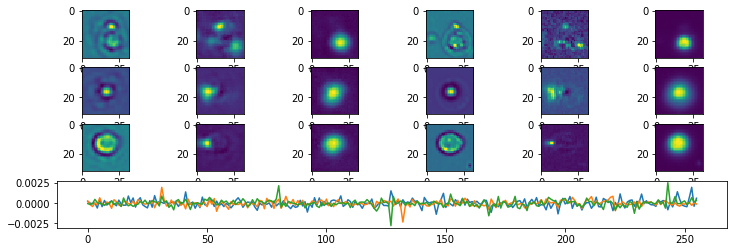

Epoch:  47 Iteration:  500 Loss:  2.1954775 1.5324942 0.6629834


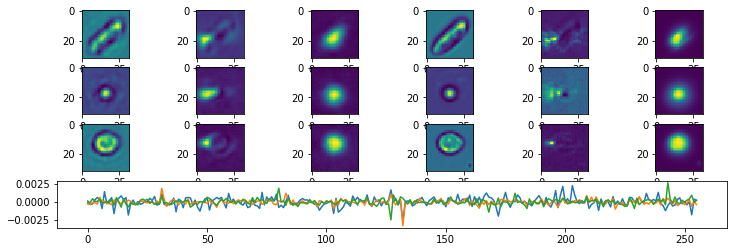

Epoch:  47 Iteration:  1000 Loss:  2.2921176 1.6645478 0.6275698


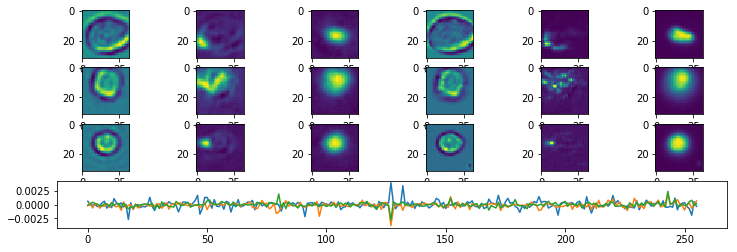

Epoch:  48 Iteration:  0 Loss:  2.0716836 1.5129693 0.5587144


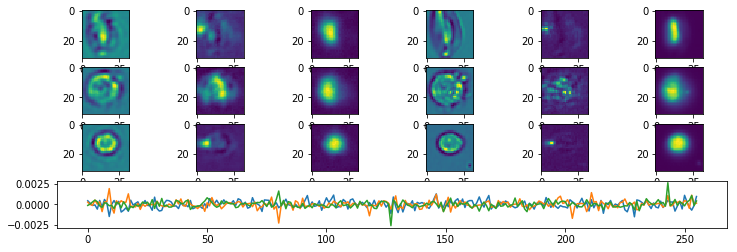

Epoch:  48 Iteration:  500 Loss:  2.052443 1.4861193 0.5663238


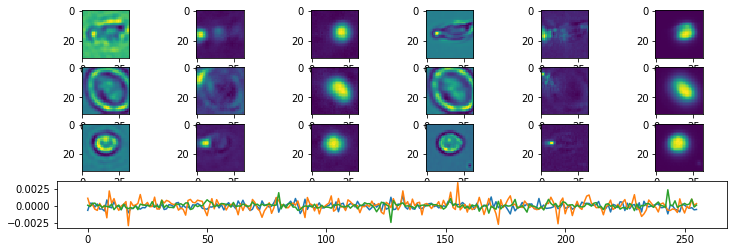

Epoch:  48 Iteration:  1000 Loss:  2.2755966 1.6496172 0.62597936


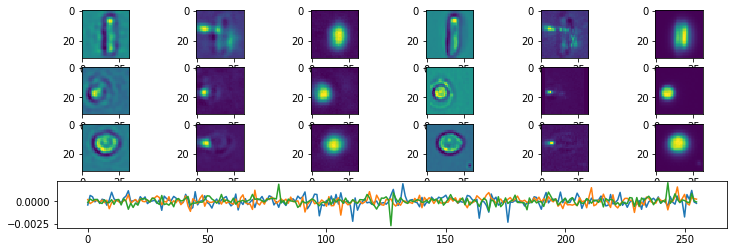

Epoch:  49 Iteration:  0 Loss:  3.2676518 1.9667734 1.3008784


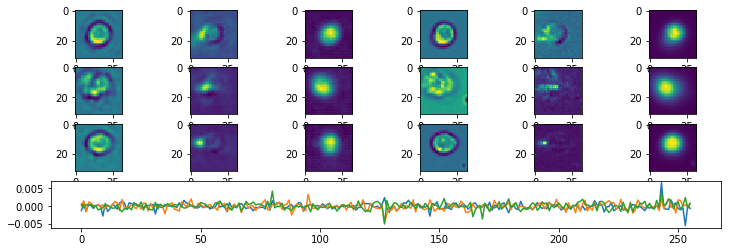

Epoch:  49 Iteration:  500 Loss:  2.6214614 1.6461909 0.97527057


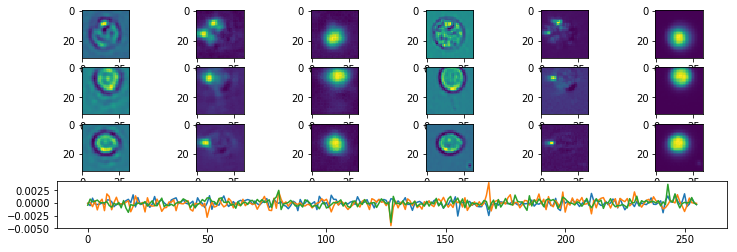

Epoch:  49 Iteration:  1000 Loss:  2.474952 1.6418236 0.8331284


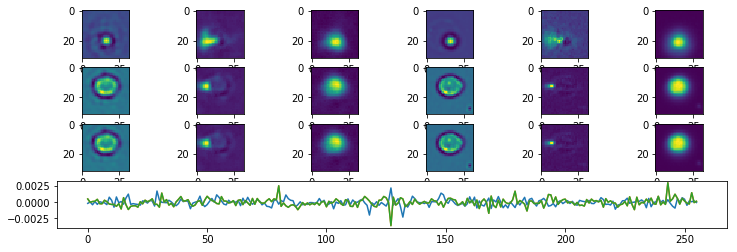

Epoch:  50 Iteration:  0 Loss:  2.2361438 1.510752 0.7253918


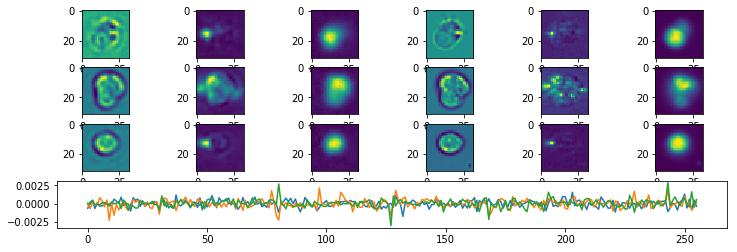

Epoch:  50 Iteration:  500 Loss:  2.1805935 1.4956319 0.6849615


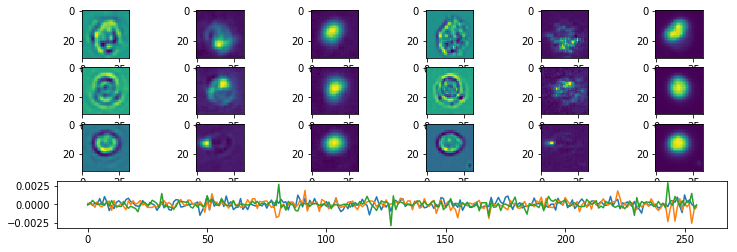

Epoch:  50 Iteration:  1000 Loss:  2.3229501 1.6444287 0.67852145


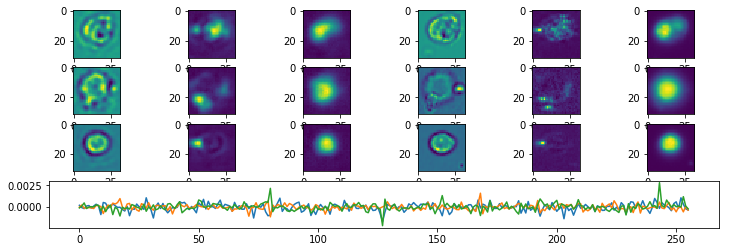

Epoch:  51 Iteration:  0 Loss:  2.0107784 1.4256315 0.585147


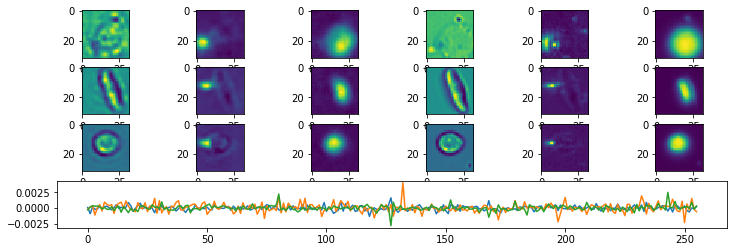

Epoch:  51 Iteration:  500 Loss:  2.0819297 1.4658399 0.61608994


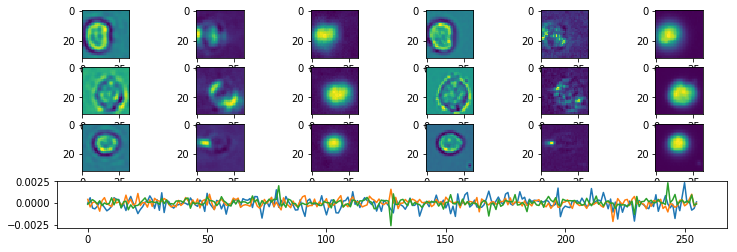

Epoch:  51 Iteration:  1000 Loss:  2.0781112 1.5086538 0.5694574


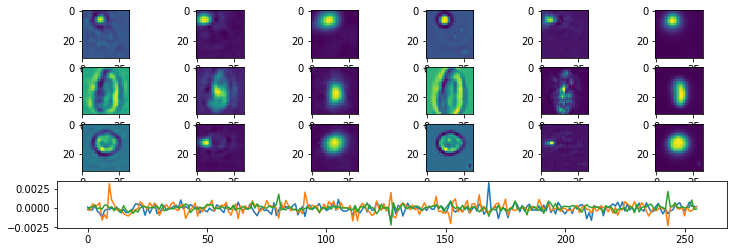

Epoch:  52 Iteration:  0 Loss:  198.56375 66.1528 132.41095


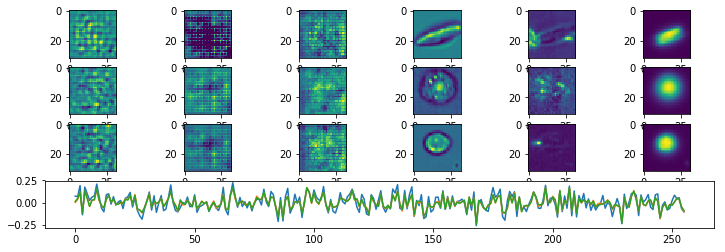

Epoch:  52 Iteration:  500 Loss:  2.7834477 1.7263954 1.0570525


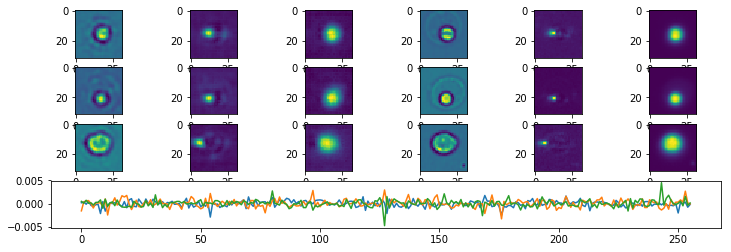

Epoch:  52 Iteration:  1000 Loss:  2.6192834 1.7343633 0.8849201


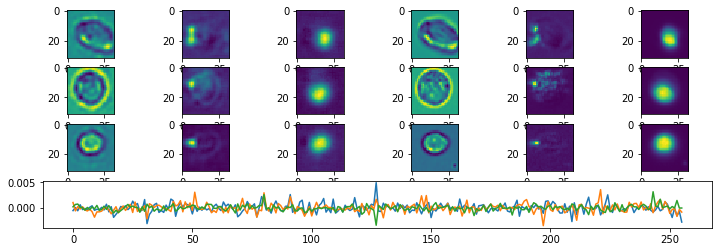

Epoch:  53 Iteration:  0 Loss:  2.2473898 1.5080047 0.73938525


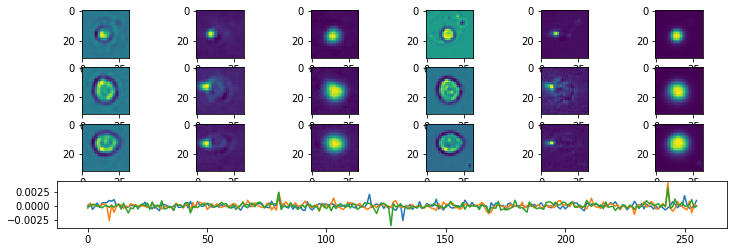

Epoch:  53 Iteration:  500 Loss:  2.1065097 1.4147592 0.69175047


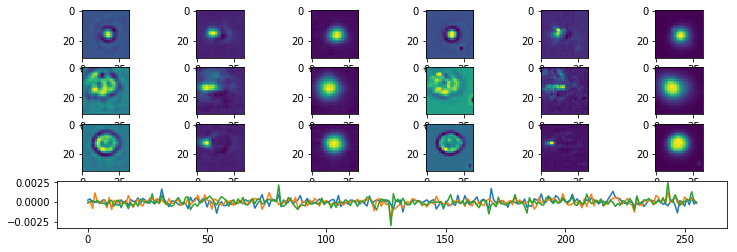

Epoch:  53 Iteration:  1000 Loss:  2.1748152 1.514076 0.6607392


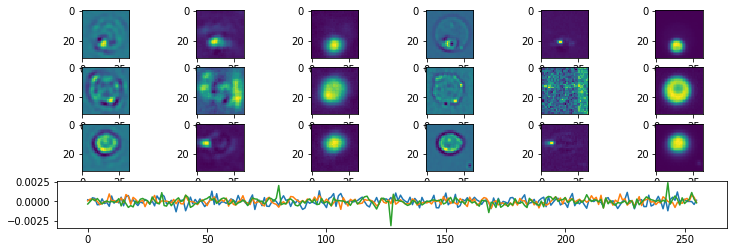

Epoch:  54 Iteration:  0 Loss:  1.9980435 1.3902907 0.6077528


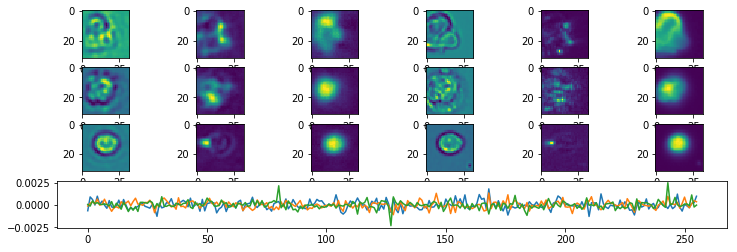

Epoch:  54 Iteration:  500 Loss:  1.9378309 1.3527086 0.5851224


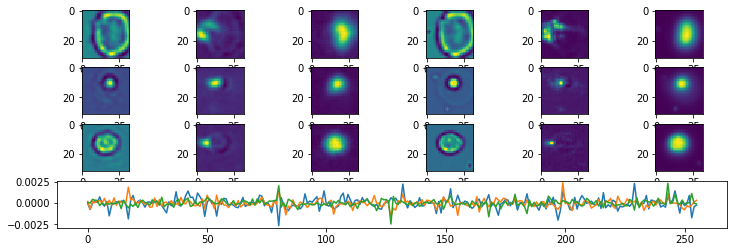

Epoch:  54 Iteration:  1000 Loss:  2.6375806 1.7328362 0.90474445


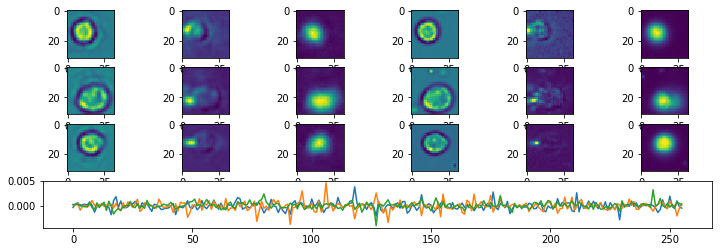

Epoch:  55 Iteration:  0 Loss:  2.086916 1.4015007 0.6854154


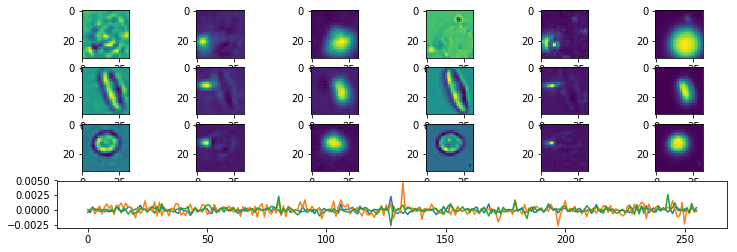

Epoch:  55 Iteration:  500 Loss:  2.0443718 1.3904012 0.65397066


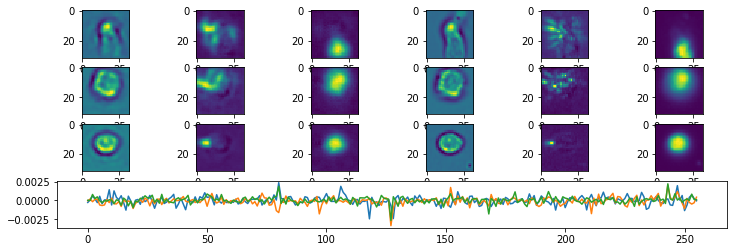

Epoch:  55 Iteration:  1000 Loss:  2.1334622 1.5302968 0.6031653


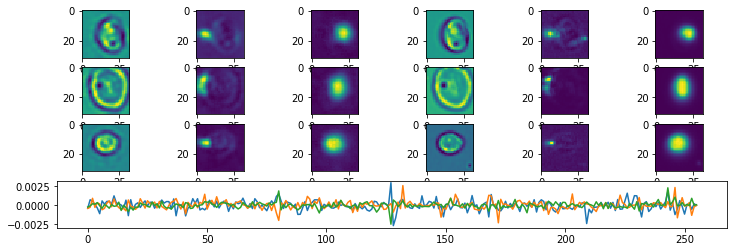

Epoch:  56 Iteration:  0 Loss:  1.9040375 1.3544779 0.54955965


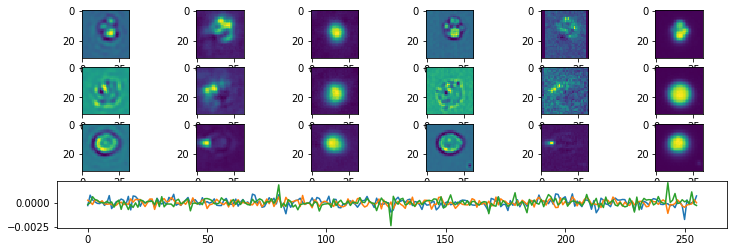

Epoch:  56 Iteration:  500 Loss:  4.1204276 2.262414 1.8580135


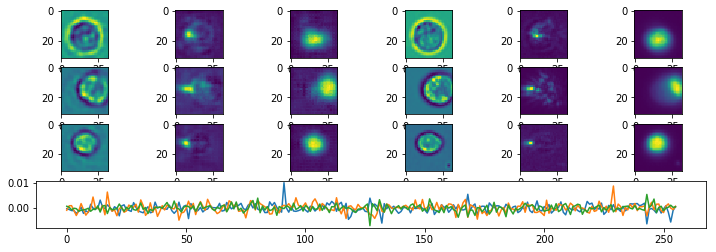

Epoch:  56 Iteration:  1000 Loss:  2.6754074 1.6909611 0.98444635


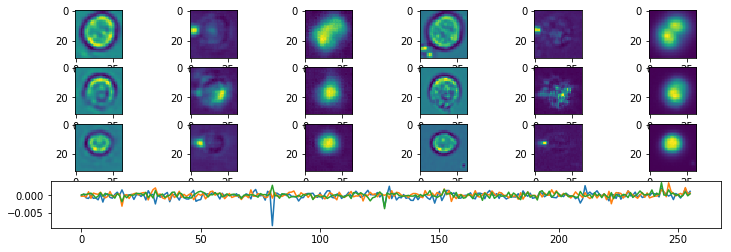

Epoch:  57 Iteration:  0 Loss:  2.3264985 1.4768124 0.84968626


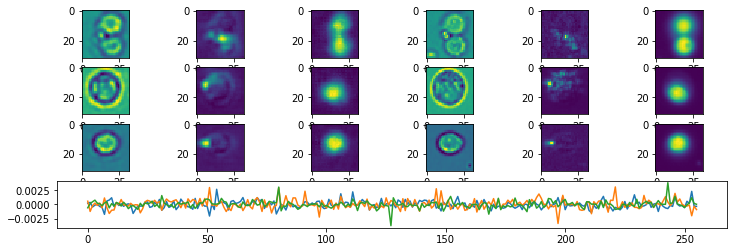

Epoch:  57 Iteration:  500 Loss:  2.239358 1.4872748 0.7520833


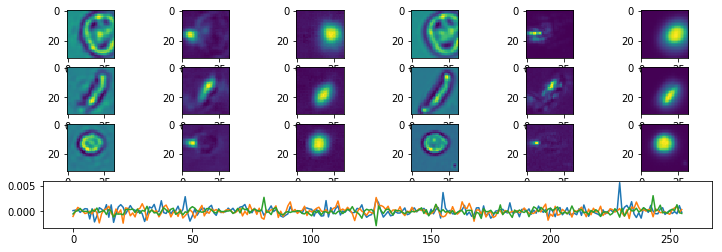

Epoch:  57 Iteration:  1000 Loss:  2.2775095 1.5736997 0.7038098


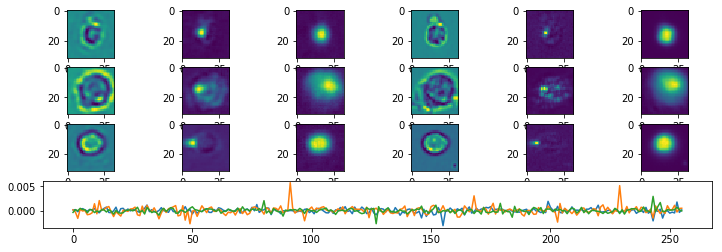

Epoch:  58 Iteration:  0 Loss:  1.9944409 1.3424435 0.65199745


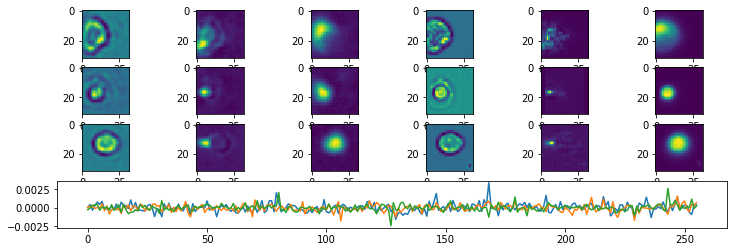

Epoch:  58 Iteration:  500 Loss:  2.078732 1.4254563 0.65327567


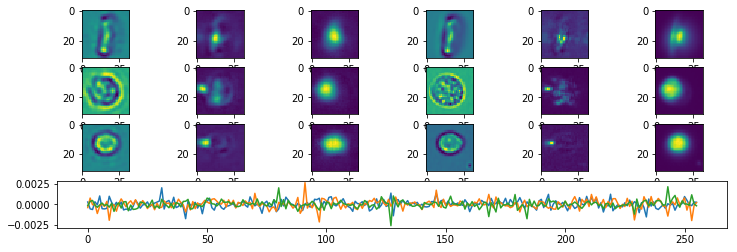

Epoch:  58 Iteration:  1000 Loss:  2.197469 1.5513474 0.6461216


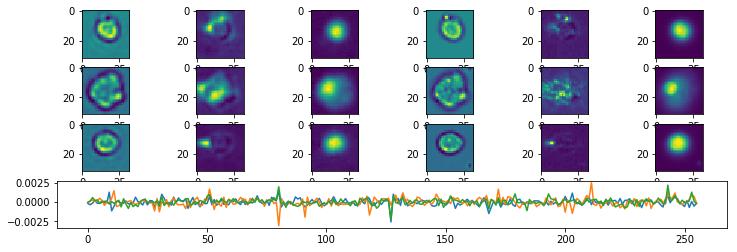

Epoch:  59 Iteration:  0 Loss:  1.9148226 1.3255874 0.5892351


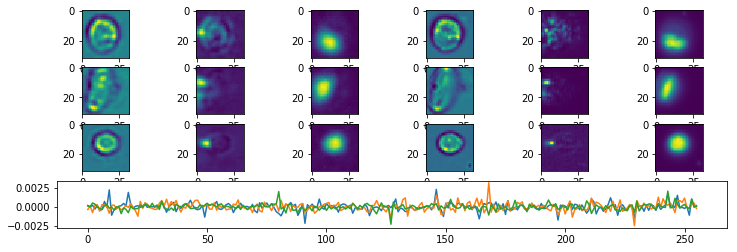

Epoch:  59 Iteration:  500 Loss:  1.8999244 1.337778 0.5621464


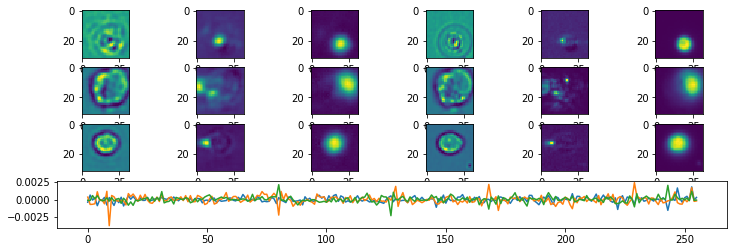

Epoch:  59 Iteration:  1000 Loss:  2.0493402 1.4977618 0.5515785


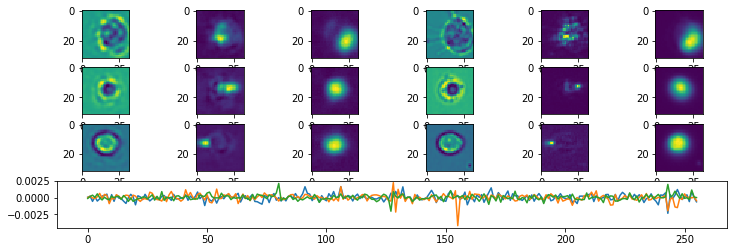

Epoch:  60 Iteration:  0 Loss:  1.8522427 1.2936426 0.5586001


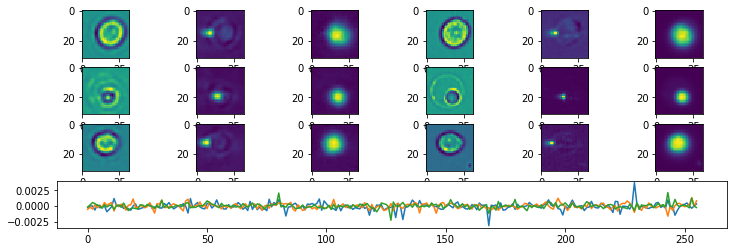

Epoch:  60 Iteration:  500 Loss:  5.613741 3.2838283 2.3299124


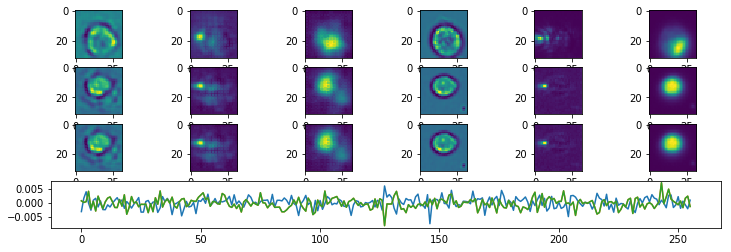

Epoch:  60 Iteration:  1000 Loss:  2.3663988 1.5369916 0.82940716


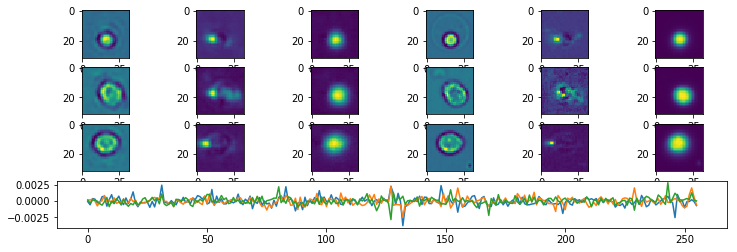

Epoch:  61 Iteration:  0 Loss:  2.0588074 1.3513217 0.70748574


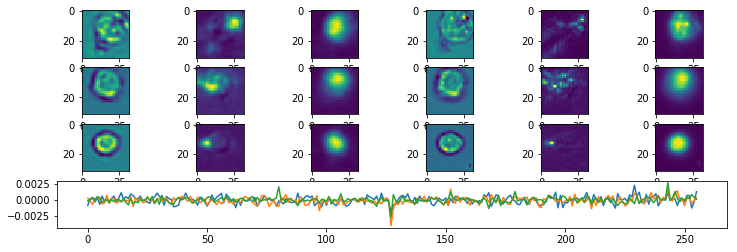

Epoch:  61 Iteration:  500 Loss:  2.0013332 1.3806834 0.6206497


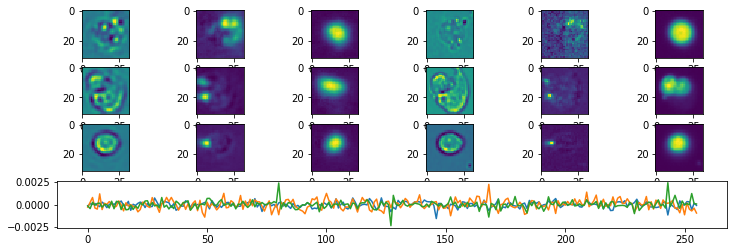

Epoch:  61 Iteration:  1000 Loss:  2.193043 1.5203071 0.672736


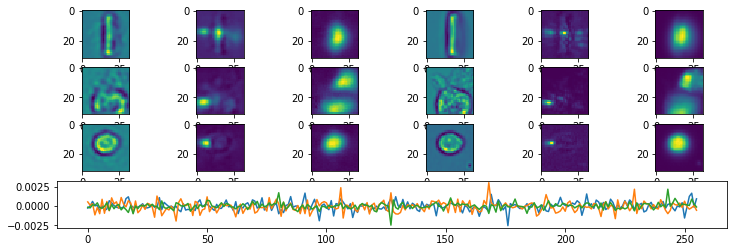

Epoch:  62 Iteration:  0 Loss:  2.0172424 1.4054095 0.6118331


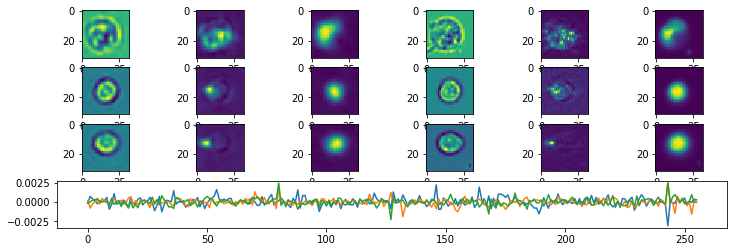

Epoch:  62 Iteration:  500 Loss:  1.8967642 1.3107499 0.5860143


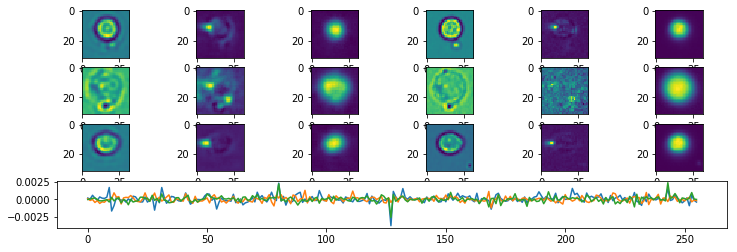

Epoch:  62 Iteration:  1000 Loss:  3.3455858 2.155589 1.1899968


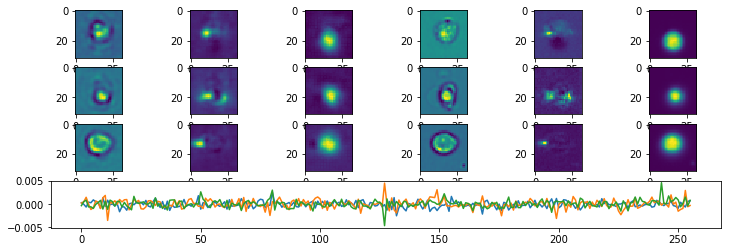

Epoch:  63 Iteration:  0 Loss:  1.9481676 1.2837342 0.6644333


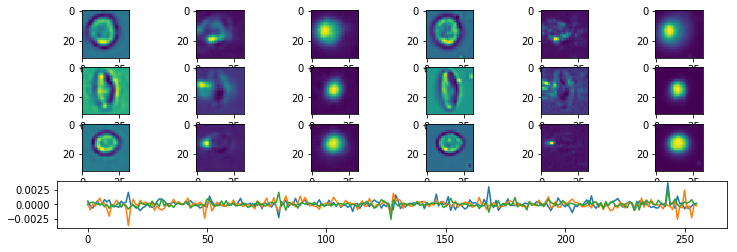

Epoch:  63 Iteration:  500 Loss:  1.9225194 1.2883626 0.6341569


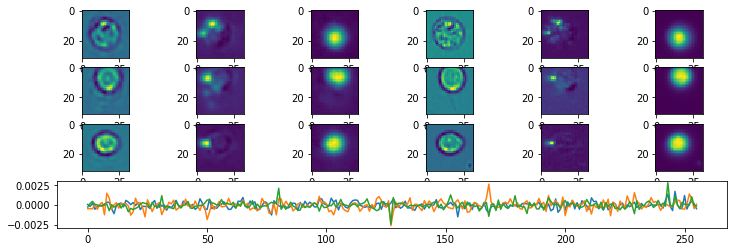

Epoch:  63 Iteration:  1000 Loss:  1.9632931 1.3750129 0.5882802


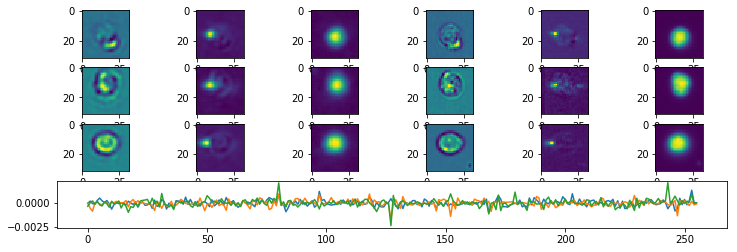

Epoch:  64 Iteration:  0 Loss:  1.8167362 1.2342844 0.5824518


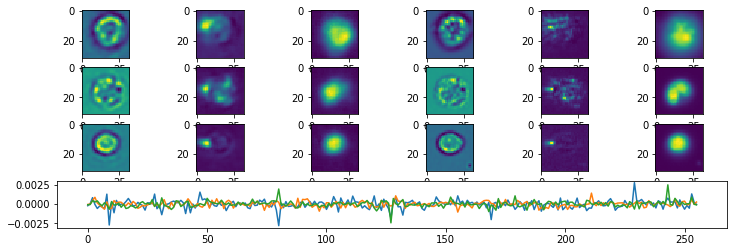

Epoch:  64 Iteration:  500 Loss:  1.9886805 1.3853732 0.60330725


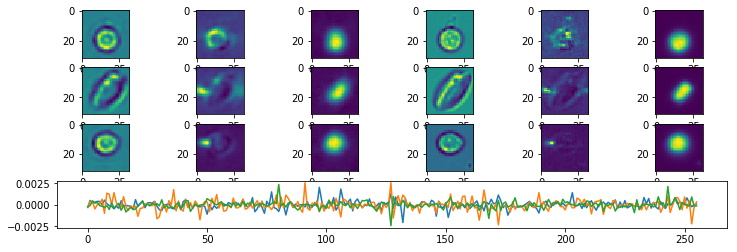

Epoch:  64 Iteration:  1000 Loss:  3.54569 2.0776594 1.4680308


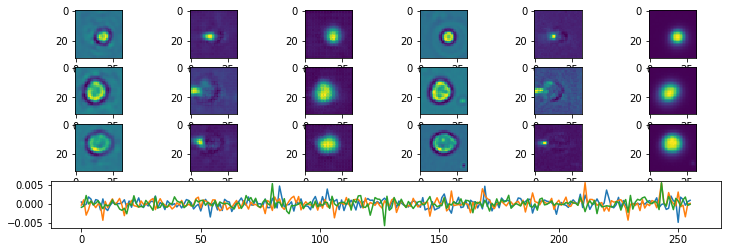

Epoch:  65 Iteration:  0 Loss:  3.316732 1.7876071 1.5291249


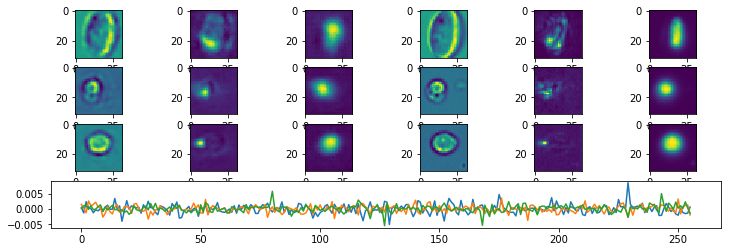

Epoch:  65 Iteration:  500 Loss:  2.2096128 1.3681077 0.84150517


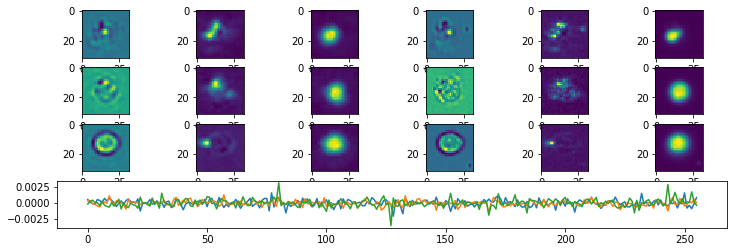

Epoch:  65 Iteration:  1000 Loss:  2.1781087 1.446219 0.73188984


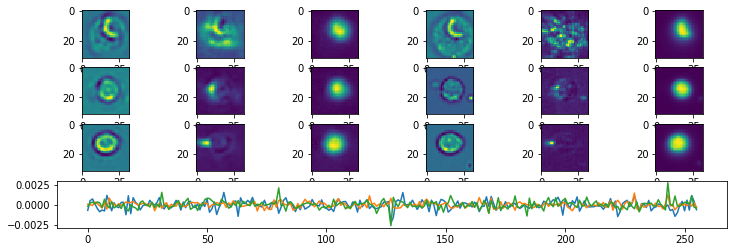

Epoch:  66 Iteration:  0 Loss:  1.8965333 1.2704796 0.62605375


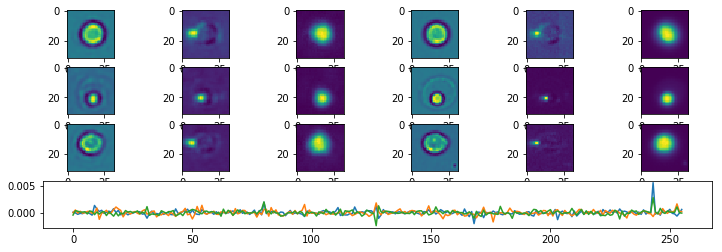

Epoch:  66 Iteration:  500 Loss:  1.9537205 1.3259943 0.6277262


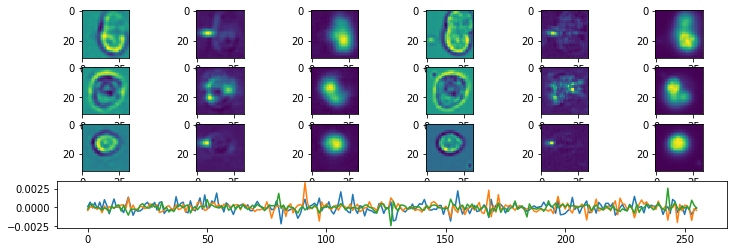

Epoch:  66 Iteration:  1000 Loss:  2.074788 1.4502602 0.624528


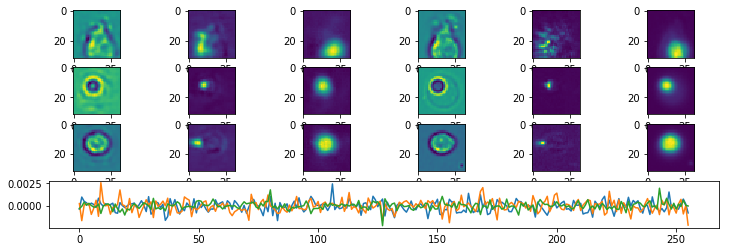

Epoch:  67 Iteration:  0 Loss:  5.2358913 2.9281554 2.3077362


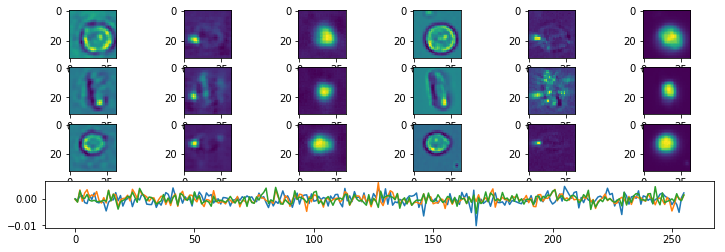

Epoch:  67 Iteration:  500 Loss:  1.9439667 1.3416973 0.6022694


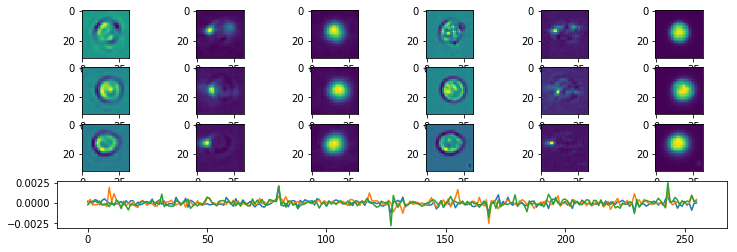

Epoch:  67 Iteration:  1000 Loss:  1.9802499 1.4076157 0.57263416


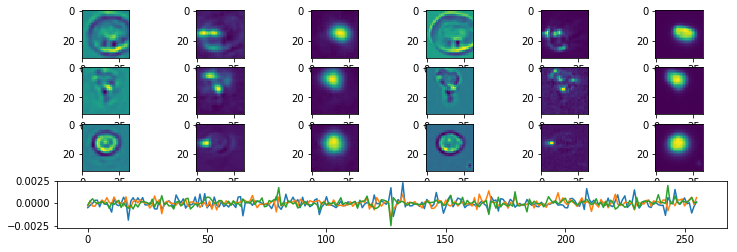

Epoch:  68 Iteration:  0 Loss:  1.9095681 1.3772345 0.53233355


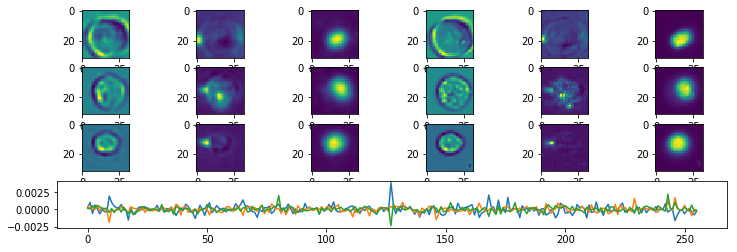

Epoch:  68 Iteration:  500 Loss:  2.5666792 1.8087058 0.7579735


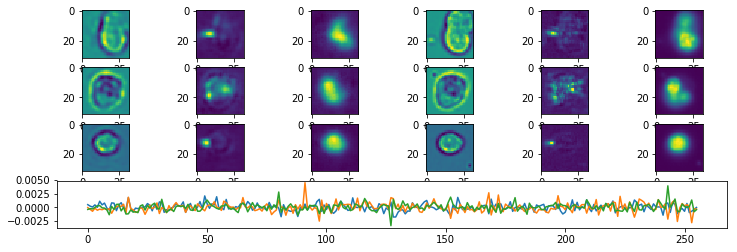

Epoch:  68 Iteration:  1000 Loss:  3.3410578 1.9659936 1.3750641


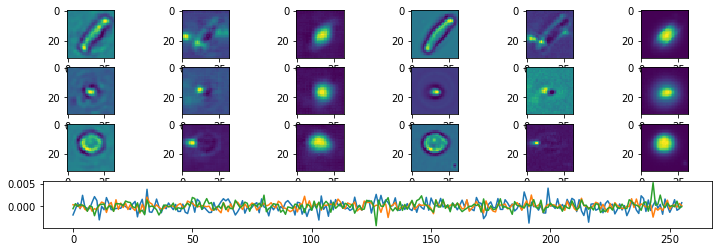

Epoch:  69 Iteration:  0 Loss:  2.3397381 1.4016542 0.9380838


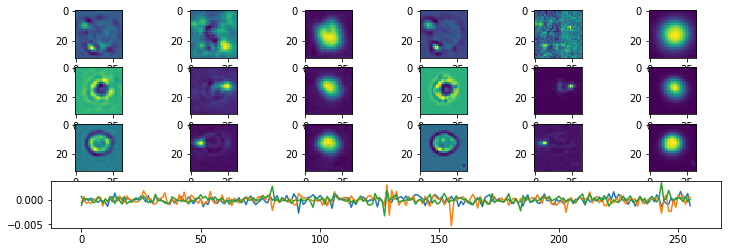

Epoch:  69 Iteration:  500 Loss:  2.231704 1.4290345 0.8026695


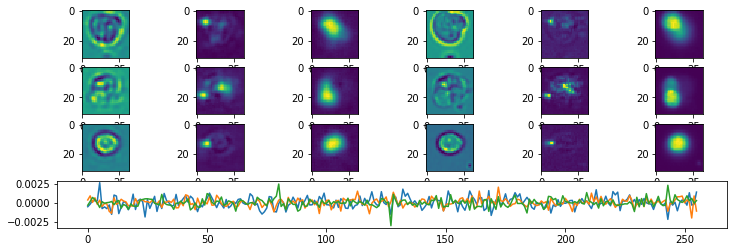

Epoch:  69 Iteration:  1000 Loss:  2.084643 1.3886487 0.6959941


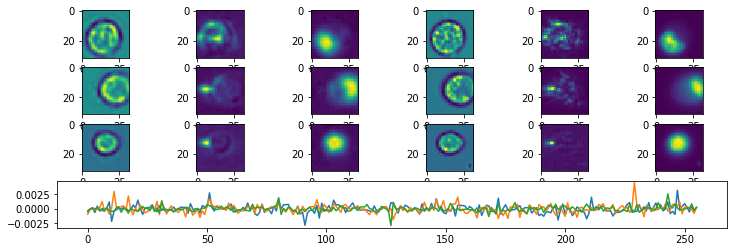

Epoch:  70 Iteration:  0 Loss:  1.8768678 1.2607477 0.6161201


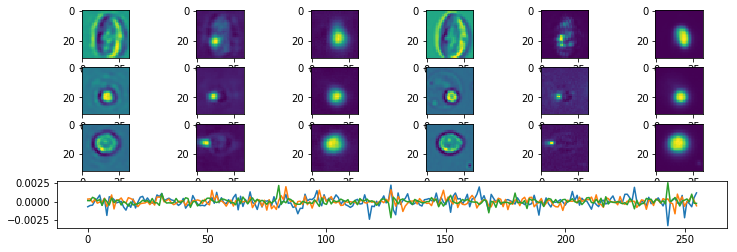

Epoch:  70 Iteration:  500 Loss:  1.8421226 1.2322571 0.60986537


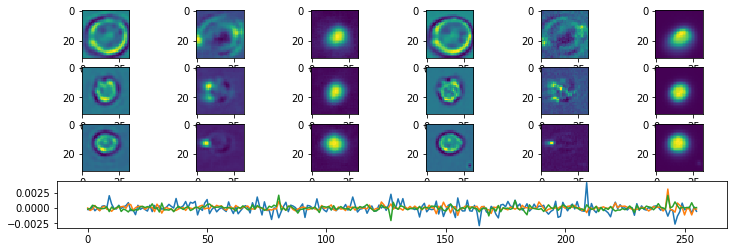

Epoch:  70 Iteration:  1000 Loss:  2.8243756 1.7233856 1.1009899


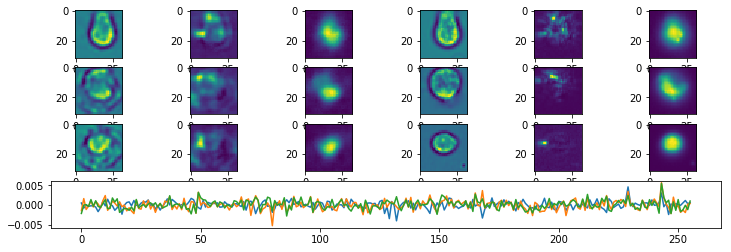

Epoch:  71 Iteration:  0 Loss:  1.7510738 1.2031405 0.5479333


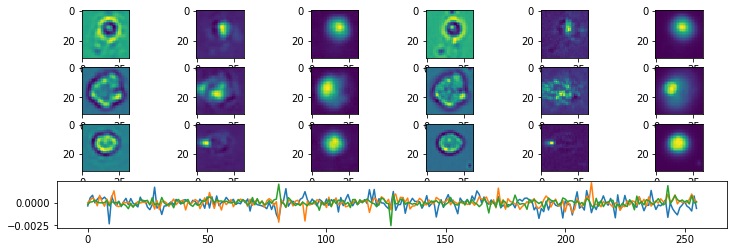

Epoch:  71 Iteration:  500 Loss:  1.799881 1.250714 0.549167


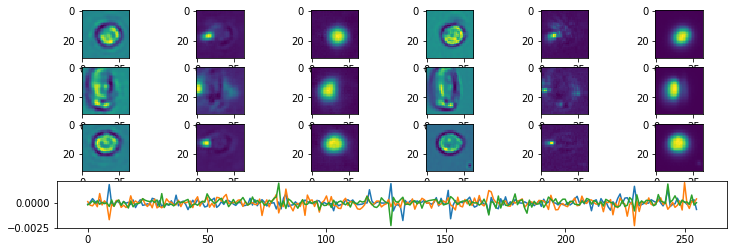

Epoch:  71 Iteration:  1000 Loss:  1.8099461 1.2500257 0.5599203


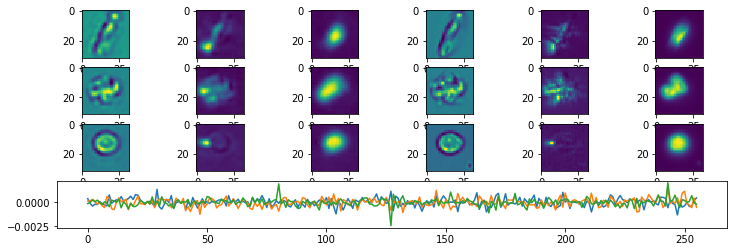

Epoch:  72 Iteration:  0 Loss:  1.7285957 1.210146 0.5184498


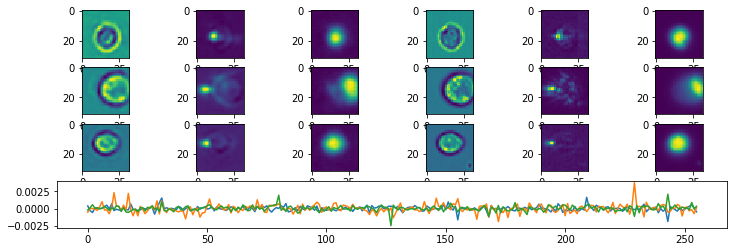

Epoch:  72 Iteration:  500 Loss:  1.7946345 1.2656424 0.52899206


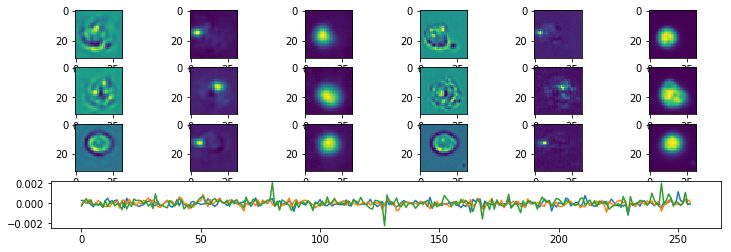

Epoch:  72 Iteration:  1000 Loss:  4.032848 2.9545848 1.0782629


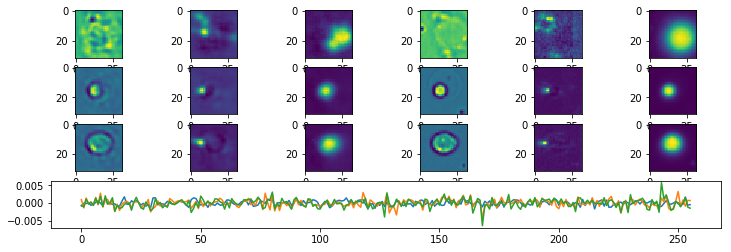

Epoch:  73 Iteration:  0 Loss:  9.522071 5.712176 3.809895


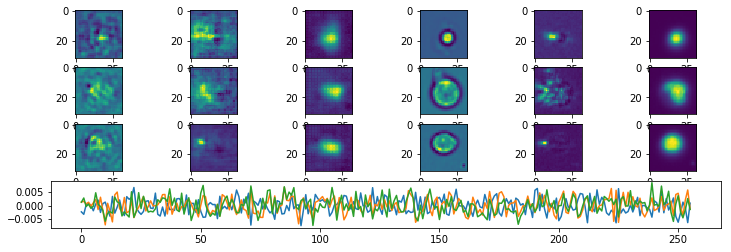

Epoch:  73 Iteration:  500 Loss:  2.7392488 1.5757961 1.1634526


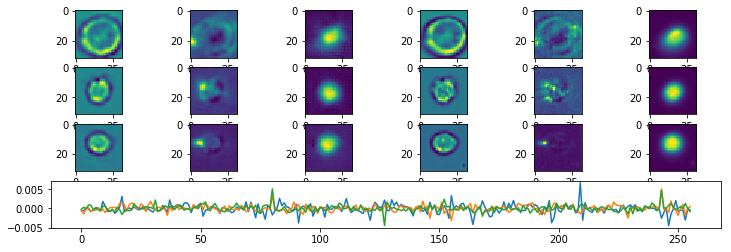

Epoch:  73 Iteration:  1000 Loss:  2.3895533 1.478866 0.9106874


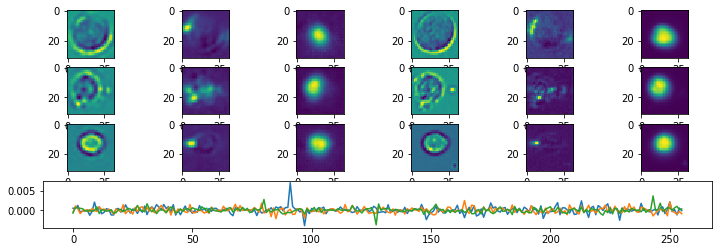

Epoch:  74 Iteration:  0 Loss:  2.0301223 1.2733767 0.75674546


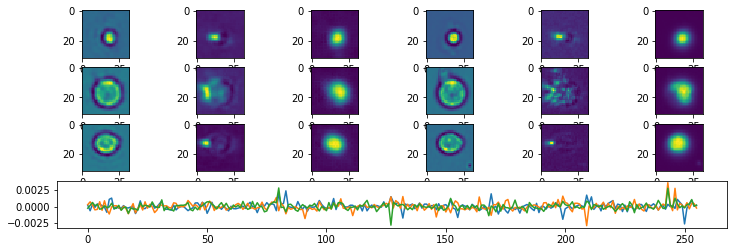

Epoch:  74 Iteration:  500 Loss:  1.9801388 1.2937789 0.6863599


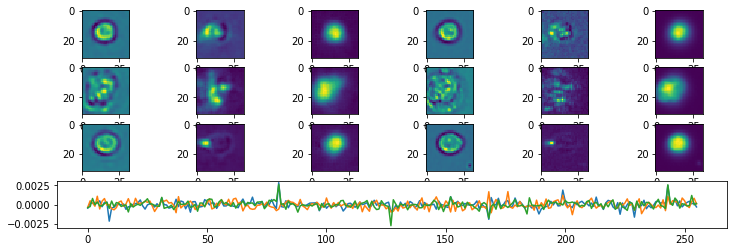

Epoch:  74 Iteration:  1000 Loss:  1.9596946 1.2929621 0.6667326


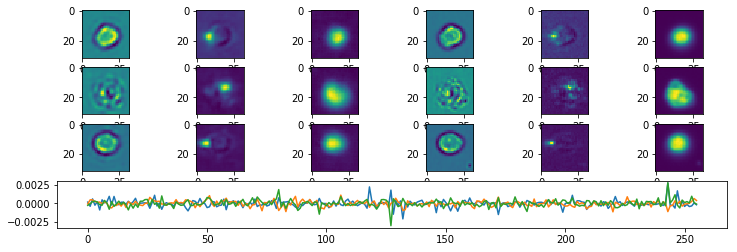

Epoch:  75 Iteration:  0 Loss:  1.7555759 1.1751813 0.58039457


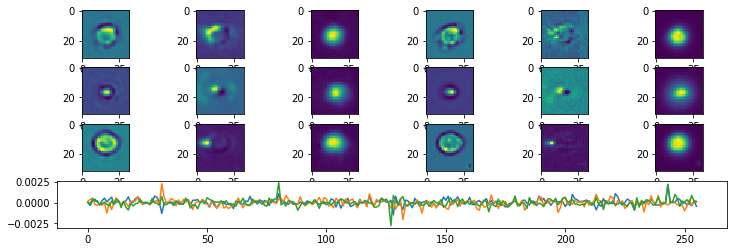

Epoch:  75 Iteration:  500 Loss:  1.7816024 1.2270147 0.55458766


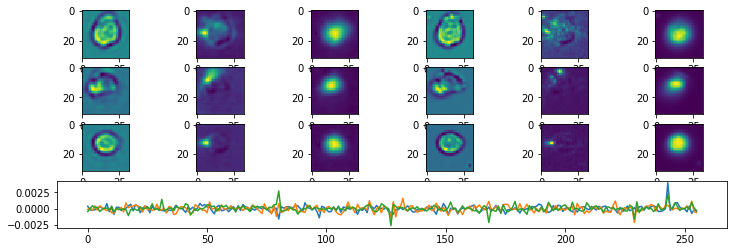

Epoch:  75 Iteration:  1000 Loss:  1.9007852 1.3340515 0.5667338


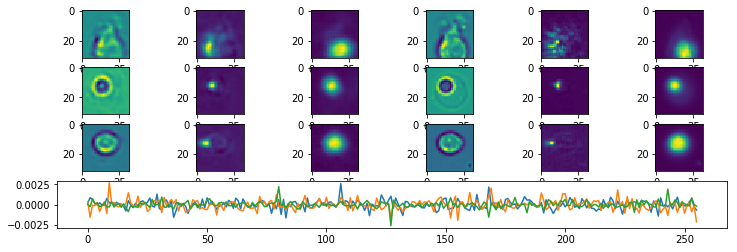

Epoch:  76 Iteration:  0 Loss:  1.7323196 1.176438 0.5558816


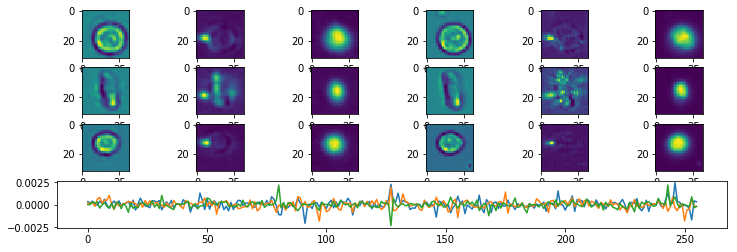

Epoch:  76 Iteration:  500 Loss:  16.606575 6.696603 9.909971


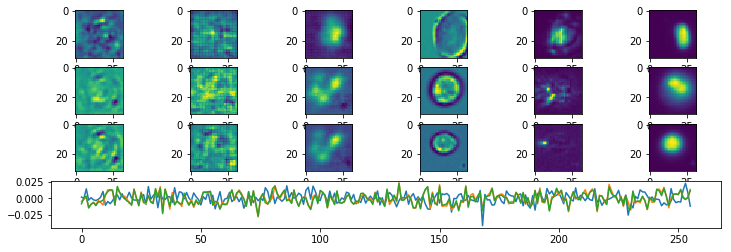

Epoch:  76 Iteration:  1000 Loss:  1.9513125 1.3748204 0.57649225


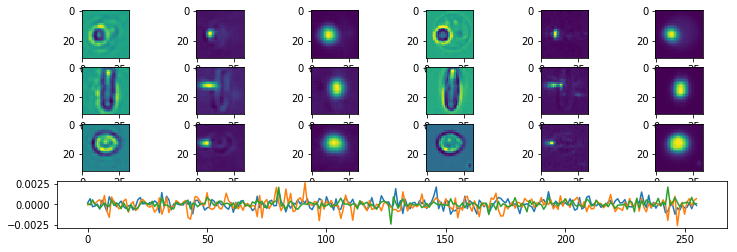

Epoch:  77 Iteration:  0 Loss:  1.6120955 1.1197903 0.4923052


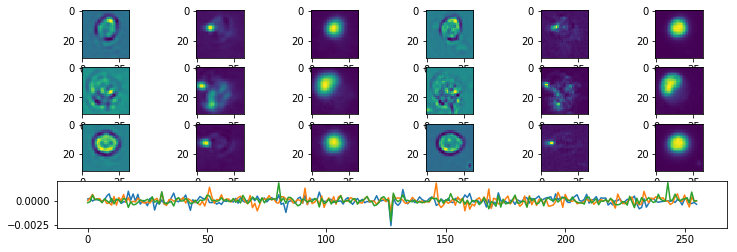

Epoch:  77 Iteration:  500 Loss:  1.6107309 1.1092334 0.5014975


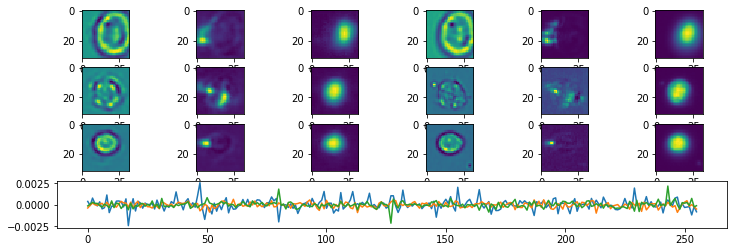

Epoch:  77 Iteration:  1000 Loss:  3.4364595 1.7423204 1.6941391


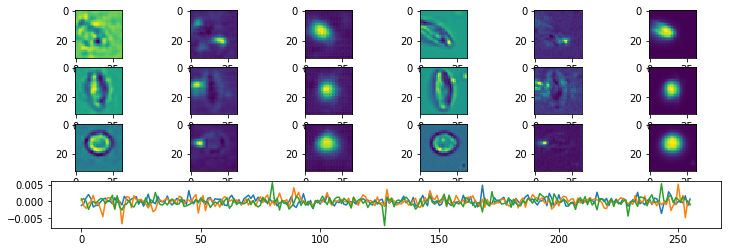

Epoch:  78 Iteration:  0 Loss:  2.339683 1.36777 0.97191316


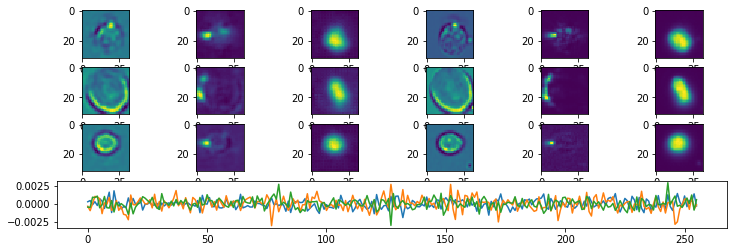

Epoch:  78 Iteration:  500 Loss:  1.9393249 1.2221416 0.71718323


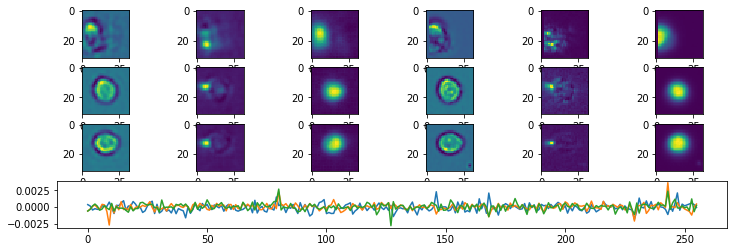

Epoch:  78 Iteration:  1000 Loss:  2.042278 1.337832 0.704446


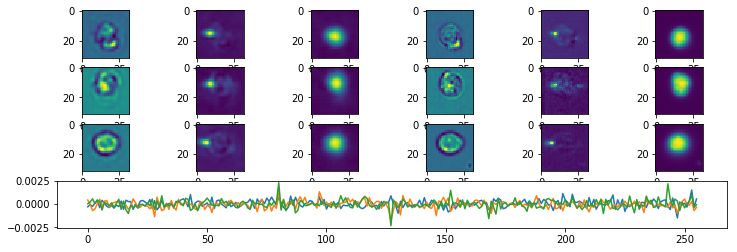

Epoch:  79 Iteration:  0 Loss:  1.8310721 1.1814227 0.6496494


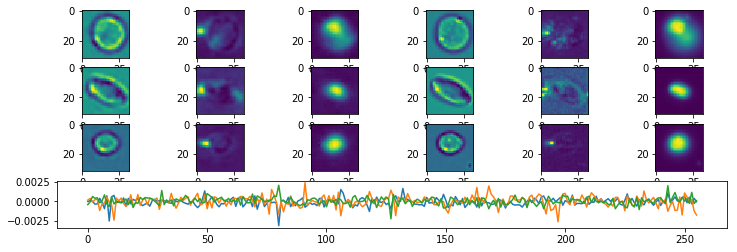

Epoch:  79 Iteration:  500 Loss:  5.4830437 2.7600403 2.7230031


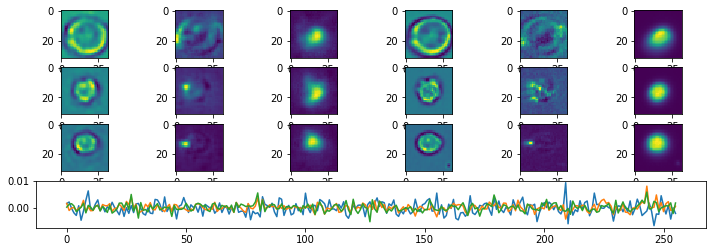

Epoch:  79 Iteration:  1000 Loss:  1.9731067 1.3510435 0.6220633


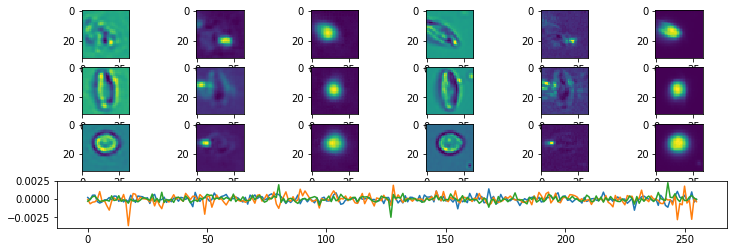

Epoch:  80 Iteration:  0 Loss:  1.6819627 1.1393412 0.5426215


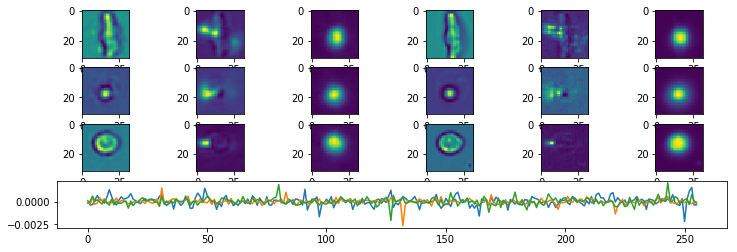

Epoch:  80 Iteration:  500 Loss:  1.7305627 1.1728139 0.55774873


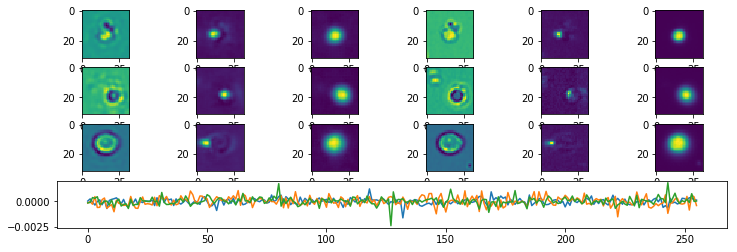

Epoch:  80 Iteration:  1000 Loss:  1.860441 1.307765 0.5526759


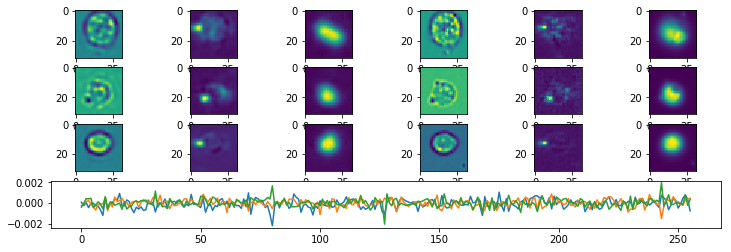

Epoch:  81 Iteration:  0 Loss:  1.693892 1.1559482 0.53794384


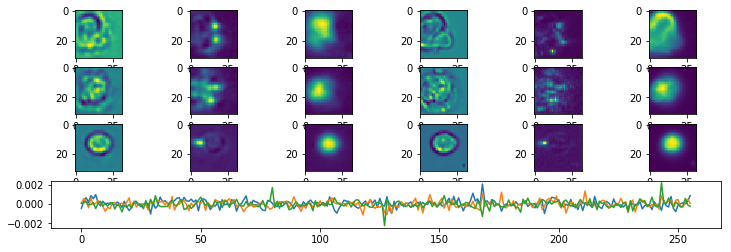

Epoch:  81 Iteration:  500 Loss:  2.8502283 1.6191895 1.2310389


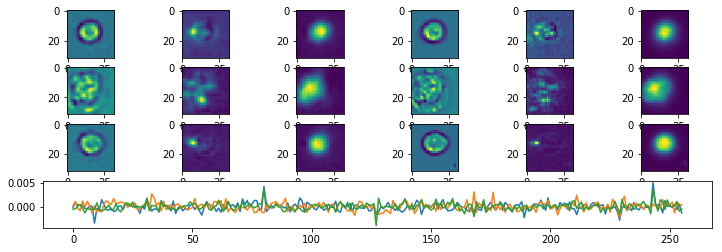

Epoch:  81 Iteration:  1000 Loss:  2.2461076 1.4192291 0.82687837


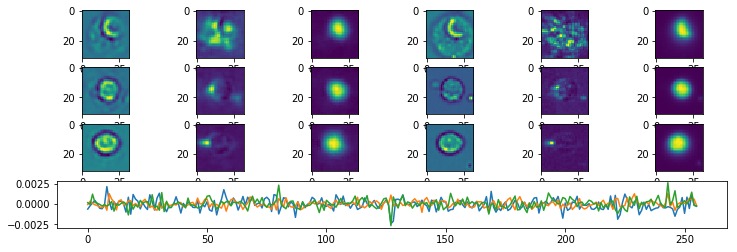

Epoch:  82 Iteration:  0 Loss:  1.8901377 1.1994076 0.69073004


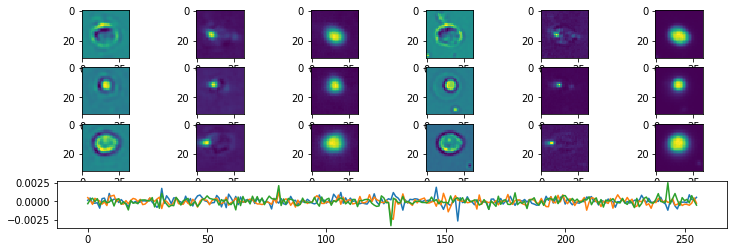

Epoch:  82 Iteration:  500 Loss:  1.719078 1.093044 0.6260339


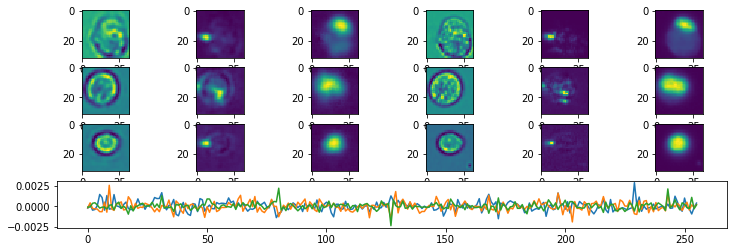

Epoch:  82 Iteration:  1000 Loss:  1.9688905 1.3438706 0.6250199


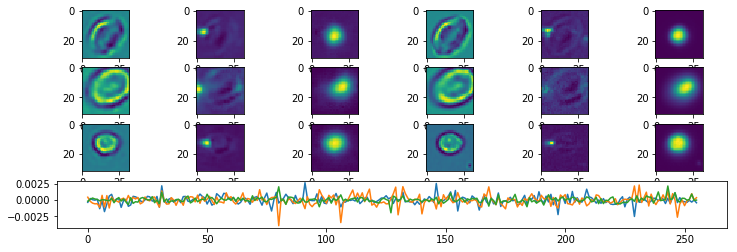

Epoch:  83 Iteration:  0 Loss:  1.6335609 1.0940912 0.5394698


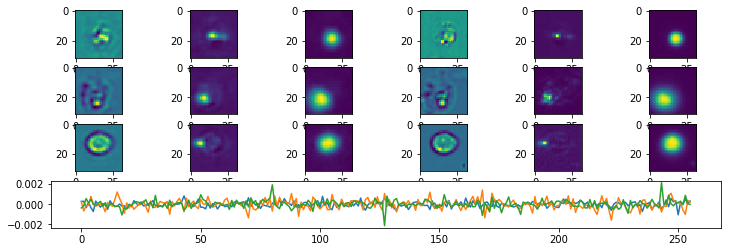

Epoch:  83 Iteration:  500 Loss:  1.6738627 1.1459086 0.52795404


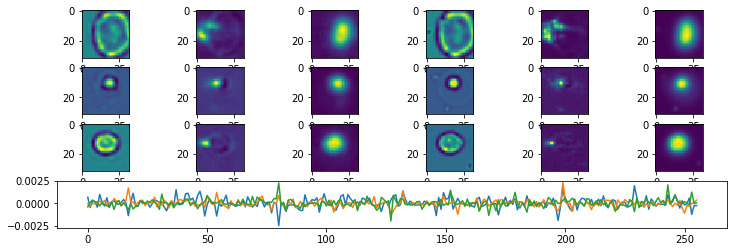

Epoch:  83 Iteration:  1000 Loss:  3.149551 1.7285993 1.4209515


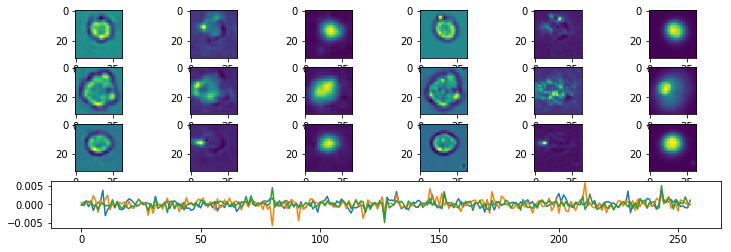

Epoch:  84 Iteration:  0 Loss:  2.041357 1.2293539 0.8120031


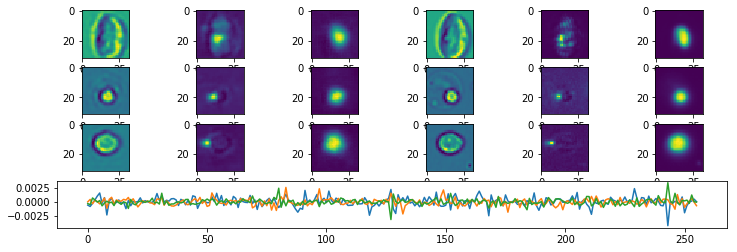

Epoch:  84 Iteration:  500 Loss:  1.8547711 1.1775739 0.6771973


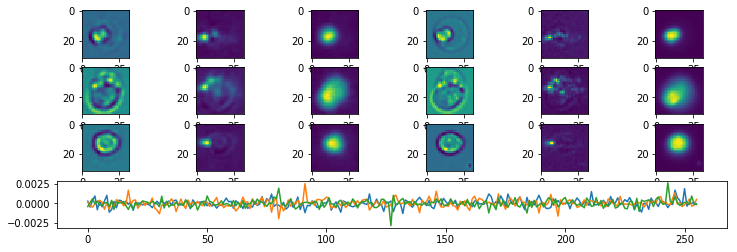

Epoch:  84 Iteration:  1000 Loss:  1.910206 1.2888904 0.6213156


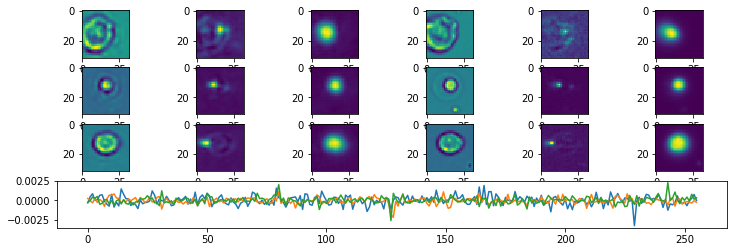

Epoch:  85 Iteration:  0 Loss:  1.6504602 1.1071343 0.5433259


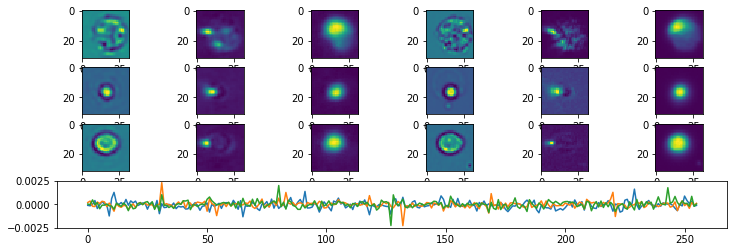

Epoch:  85 Iteration:  500 Loss:  1.6599953 1.1317437 0.52825165


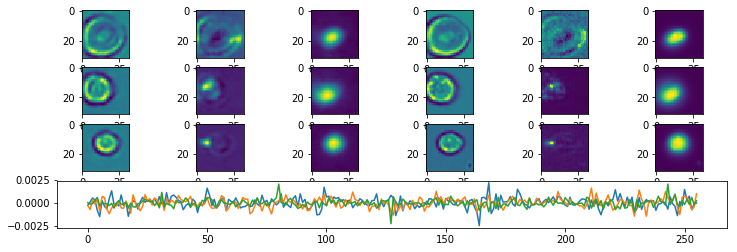

Epoch:  85 Iteration:  1000 Loss:  1.8597727 1.2520897 0.6076829


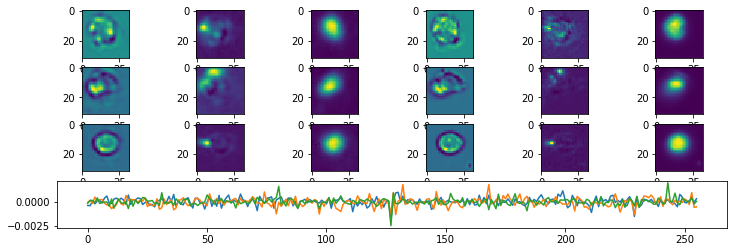

Epoch:  86 Iteration:  0 Loss:  5.129713 3.1169348 2.0127785


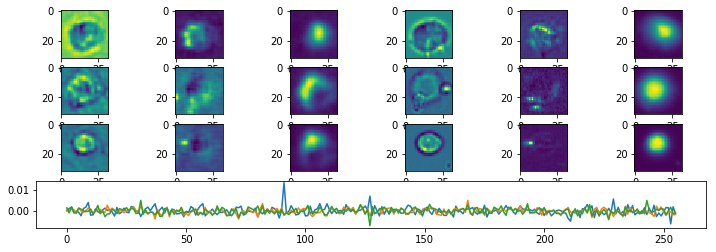

Epoch:  86 Iteration:  500 Loss:  1.7377918 1.1481364 0.5896554


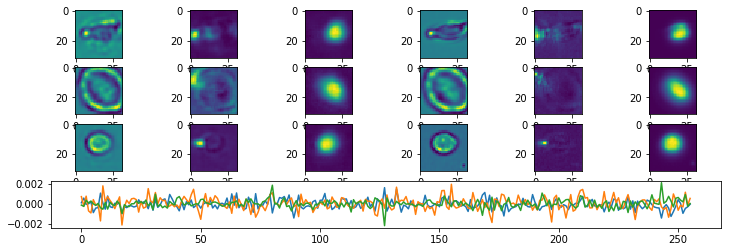

Epoch:  86 Iteration:  1000 Loss:  1.9545554 1.3629519 0.5916035


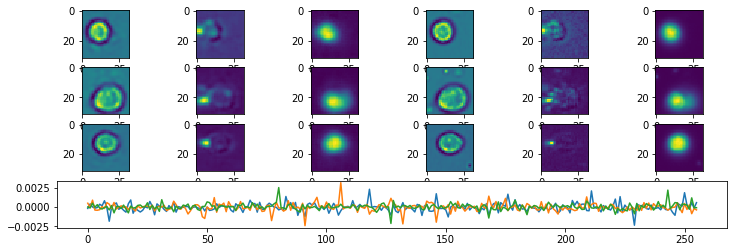

Epoch:  87 Iteration:  0 Loss:  1.6112297 1.1123844 0.4988452


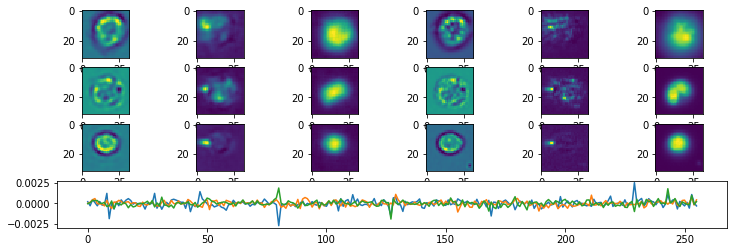

Epoch:  87 Iteration:  500 Loss:  1.5812459 1.0692904 0.51195556


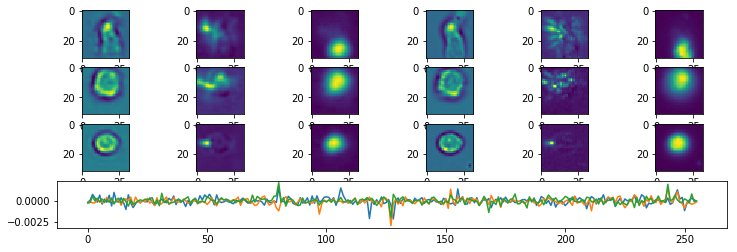

Epoch:  87 Iteration:  1000 Loss:  2.9629261 1.7429186 1.2200075


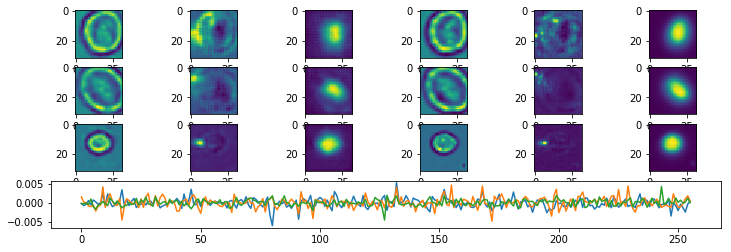

Epoch:  88 Iteration:  0 Loss:  2.1256578 1.2713842 0.8542736


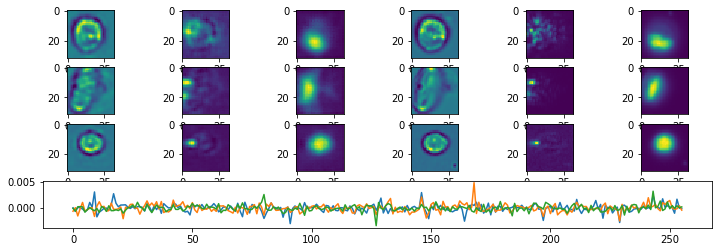

Epoch:  88 Iteration:  500 Loss:  1.9851446 1.2715694 0.7135753


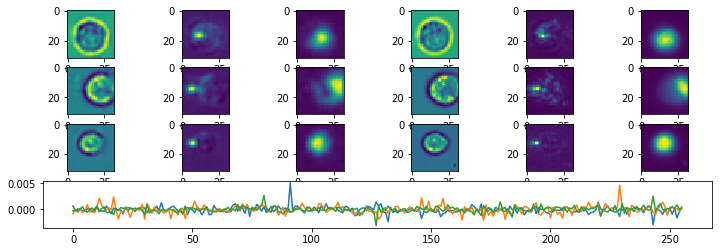

Epoch:  88 Iteration:  1000 Loss:  1.8706679 1.2458209 0.6248471


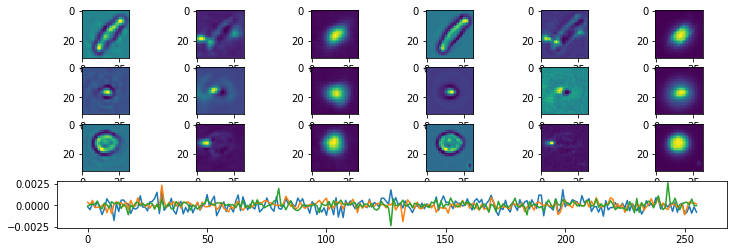

Epoch:  89 Iteration:  0 Loss:  1.6942961 1.1042823 0.5900138


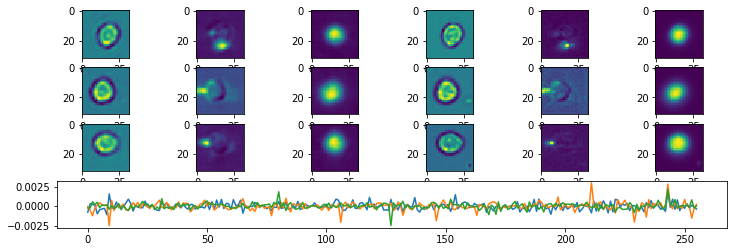

Epoch:  89 Iteration:  500 Loss:  1.7349865 1.1349318 0.6000547


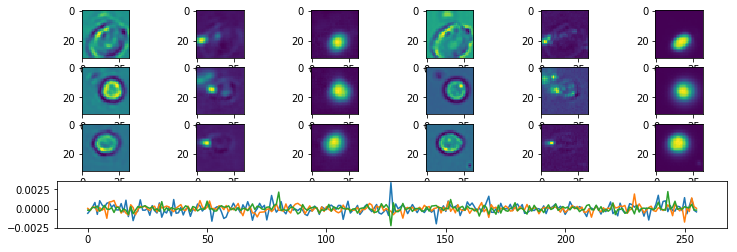

Epoch:  89 Iteration:  1000 Loss:  1.7160122 1.152482 0.56353027


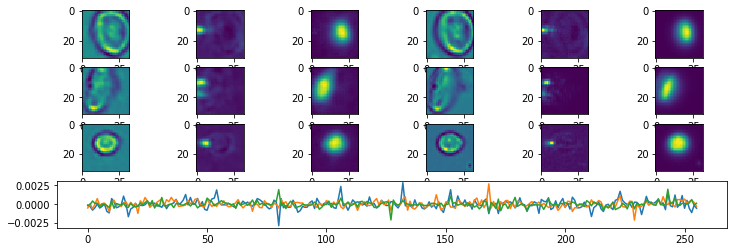

Epoch:  90 Iteration:  0 Loss:  1.6020954 1.074764 0.5273313


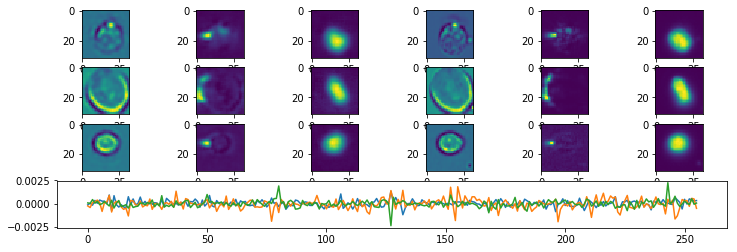

Epoch:  90 Iteration:  500 Loss:  1.7141715 1.1260595 0.588112


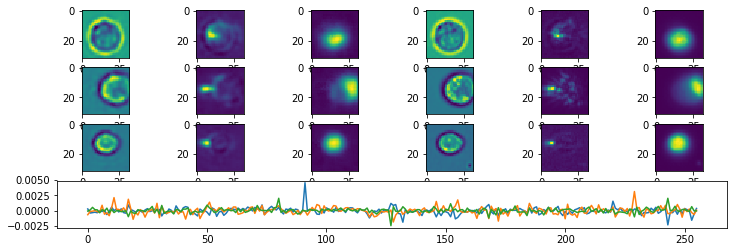

Epoch:  90 Iteration:  1000 Loss:  1.6982152 1.1483355 0.5498798


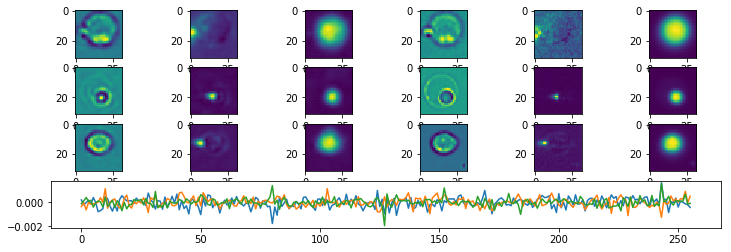

Epoch:  91 Iteration:  0 Loss:  2.5635185 1.4813704 1.0821482


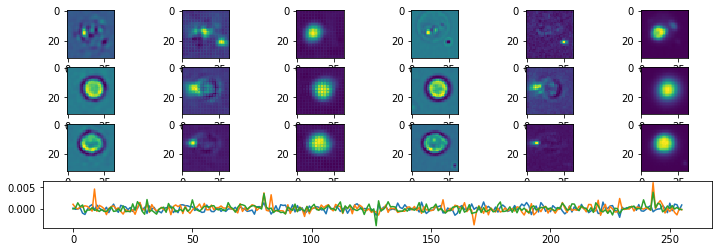

Epoch:  91 Iteration:  500 Loss:  2.3352792 1.3067831 1.0284961


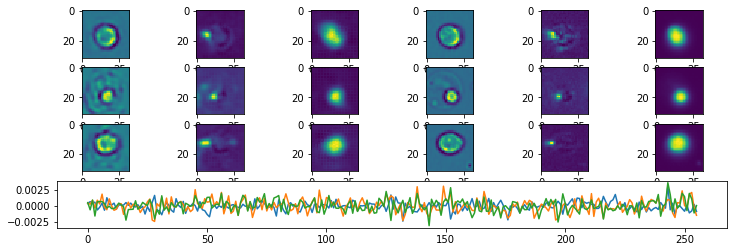

Epoch:  91 Iteration:  1000 Loss:  1.9443545 1.2619277 0.68242675


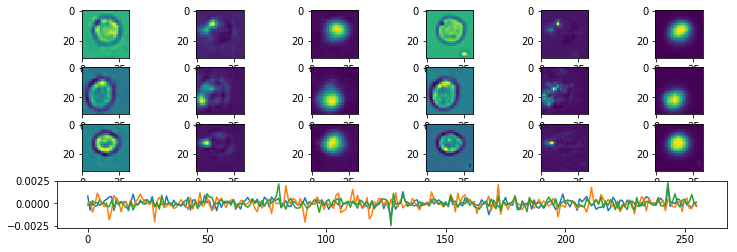

Epoch:  92 Iteration:  0 Loss:  1.6686006 1.0878835 0.58071715


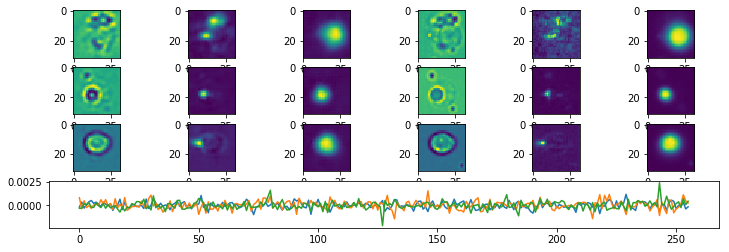

Epoch:  92 Iteration:  500 Loss:  1.8105168 1.1834847 0.6270322


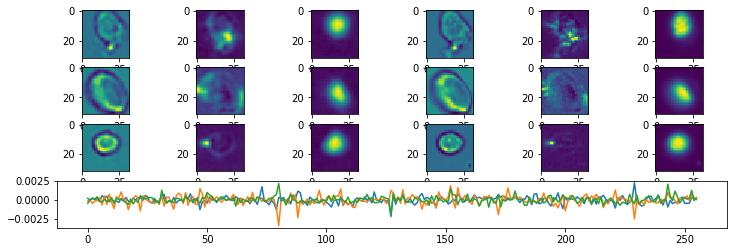

Epoch:  92 Iteration:  1000 Loss:  1.8141149 1.225429 0.58868587


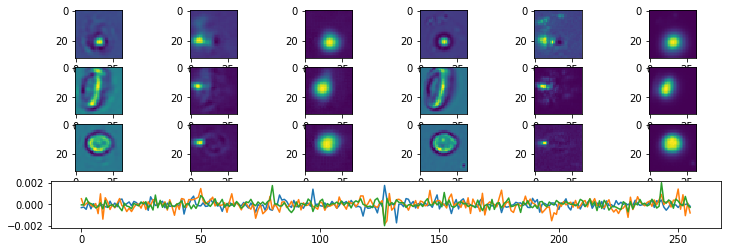

Epoch:  93 Iteration:  0 Loss:  1.8907671 1.2219913 0.66877574


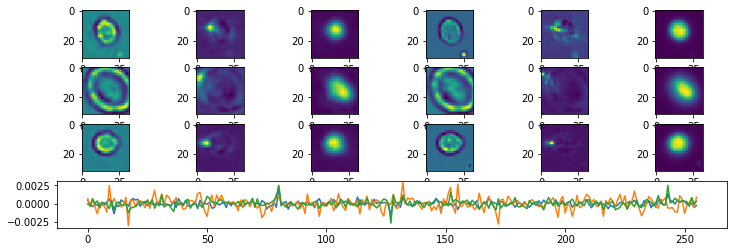

Epoch:  93 Iteration:  500 Loss:  1.5577054 1.057571 0.5001343


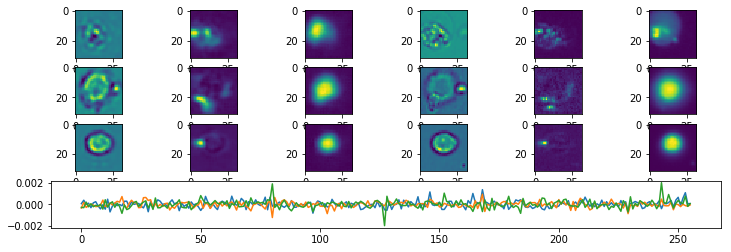

Epoch:  93 Iteration:  1000 Loss:  1.7020843 1.1880001 0.51408416


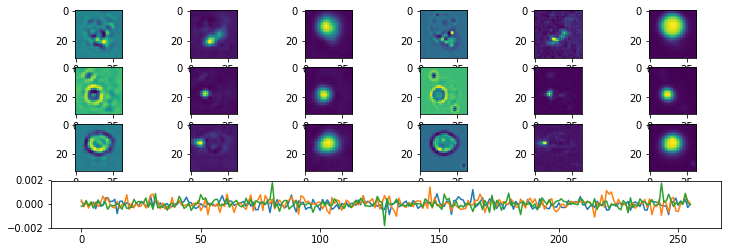

Epoch:  94 Iteration:  0 Loss:  1.515107 1.0371611 0.4779459


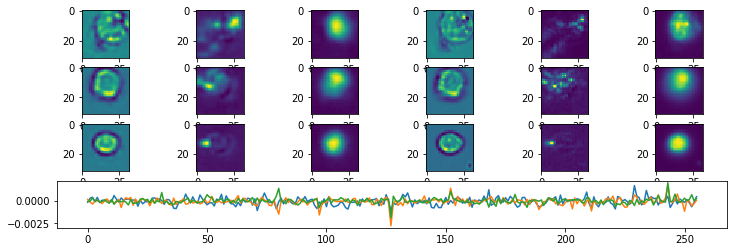

Epoch:  94 Iteration:  500 Loss:  1.6672959 1.0682049 0.599091


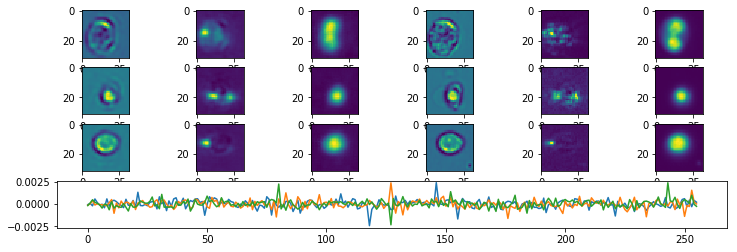

Epoch:  94 Iteration:  1000 Loss:  1.7494819 1.2045888 0.5448932


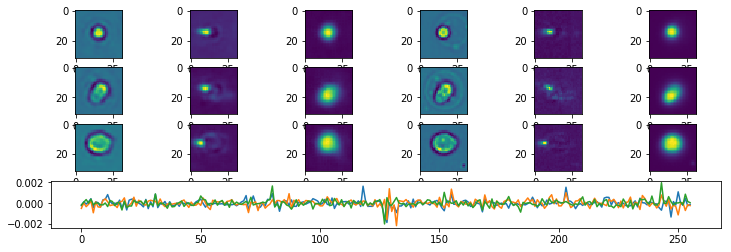

Epoch:  95 Iteration:  0 Loss:  1.5314639 1.0461946 0.48526928


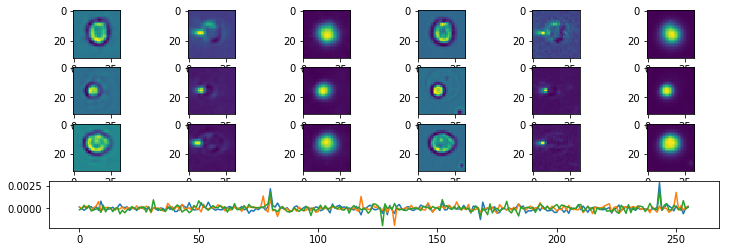

Epoch:  95 Iteration:  500 Loss:  2.3138542 1.3253264 0.9885279


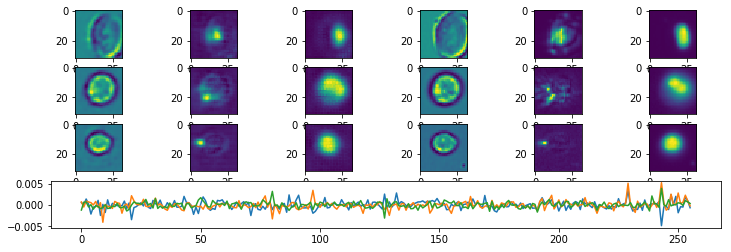

Epoch:  95 Iteration:  1000 Loss:  2.0123358 1.233859 0.7784769


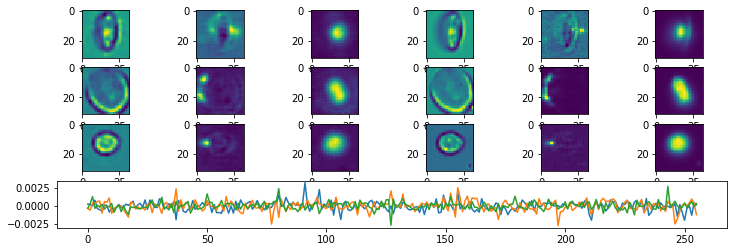

Epoch:  96 Iteration:  0 Loss:  1.7938138 1.1204878 0.673326


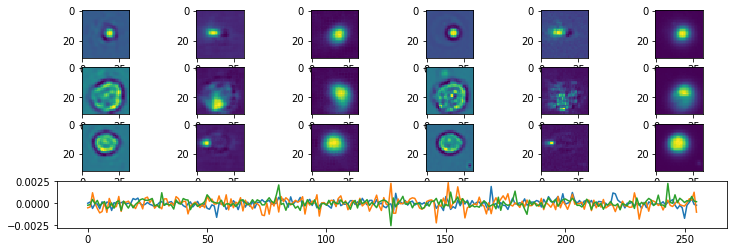

Epoch:  96 Iteration:  500 Loss:  1.7278469 1.0934926 0.6343542


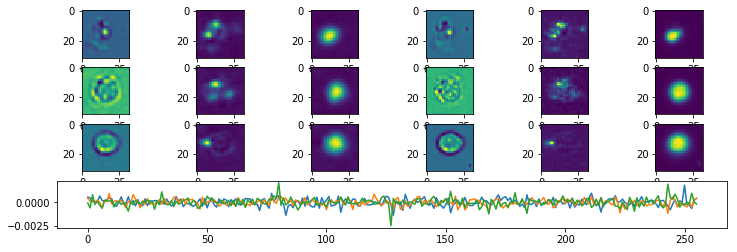

Epoch:  96 Iteration:  1000 Loss:  1.9017613 1.272058 0.6297032


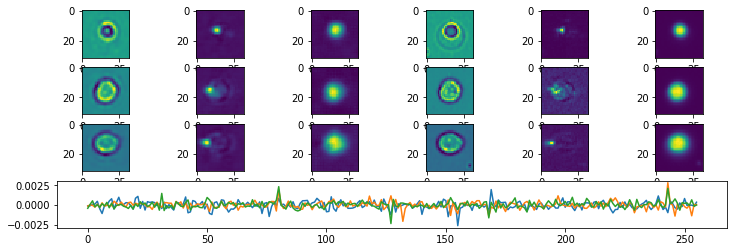

Epoch:  97 Iteration:  0 Loss:  1.6283455 1.0770612 0.55128425


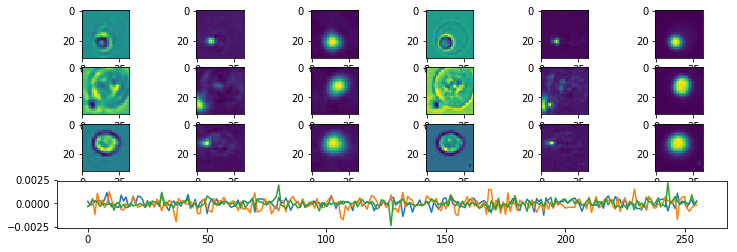

Epoch:  97 Iteration:  500 Loss:  1.7363744 1.1562967 0.5800776


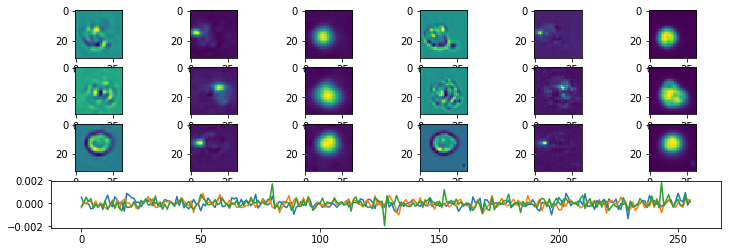

Epoch:  97 Iteration:  1000 Loss:  1.7441974 1.1870847 0.55711275


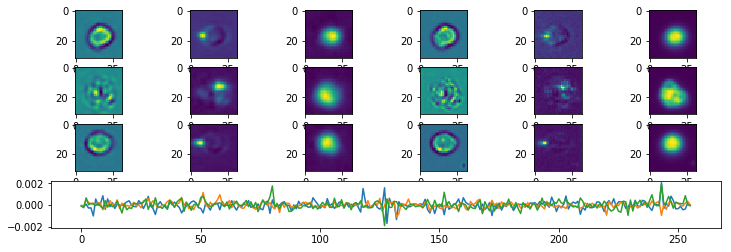

Epoch:  98 Iteration:  0 Loss:  1.8799431 1.1153021 0.7646411


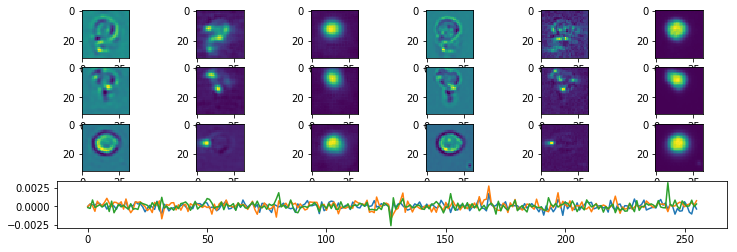

Epoch:  98 Iteration:  500 Loss:  1.7710588 1.1864423 0.58461654


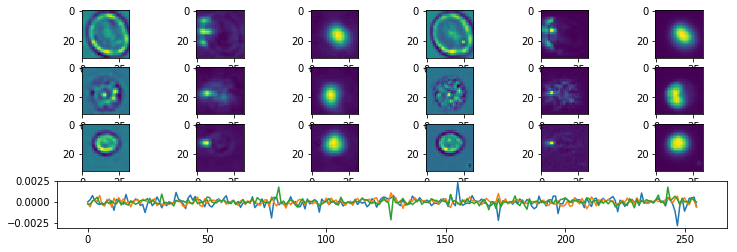

Epoch:  98 Iteration:  1000 Loss:  1.6051639 1.1152253 0.4899386


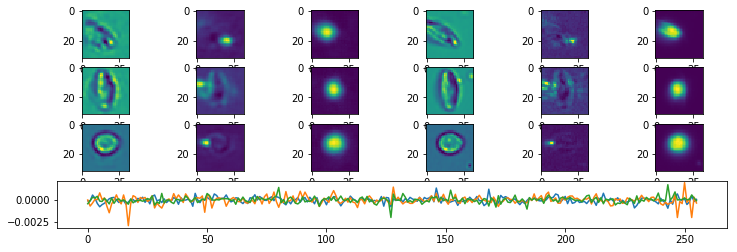

Epoch:  99 Iteration:  0 Loss:  6.172166 3.964932 2.207234


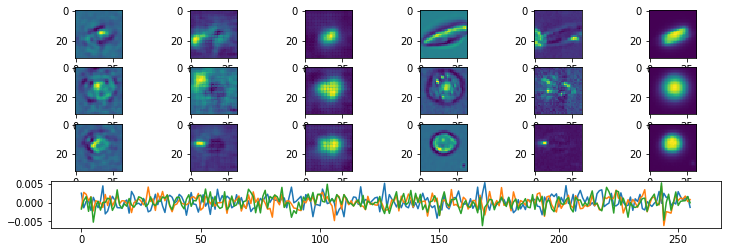

Epoch:  99 Iteration:  500 Loss:  2.1907558 1.3033577 0.8873982


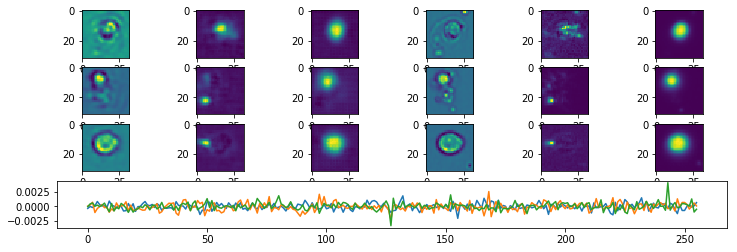

Epoch:  99 Iteration:  1000 Loss:  2.017829 1.2718728 0.74595624


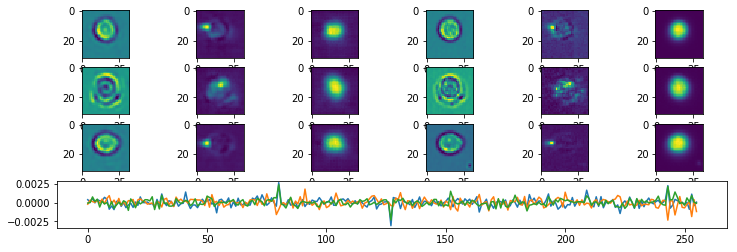

Done


In [4]:

p_mmdict = mmdict #{"Fish6_15_cjw_64.tif.mm": m3}
#             "plate04_all.mm": m4}

p_width = 32
p_height = 32
p_nchannels = 3
p_channels = [0,2,4]
p_nepochs = 100
p_batchsize = 128
p_learning_rate = 0.0002  #.00005
p_restore = False
p_latent_size = 256 #128 + 64
p_droprate = 0.95
p_stdev = .04

enc_sizes = [(128, 3), (256, 3), (512, 3)]  #128, 3)]
######enc_sizes = [(64, 3), (128, 3), (256,3), (512,3)] #, (64, 3), (128,3)] #, (32, 3), (64, 3)]
#enc_sizes = [(16, 5), (32, 3), (64,3), (128,3)] #, (64, 3), (128,3)] #, (32, 3), (64, 3)]
dec_sizes = list(reversed(enc_sizes))
#dec_sizes.append((p_nchannels,7))

params = dict()

params['width'] = p_width
params['height'] = p_height
params['nchannels'] = p_nchannels
params['channels'] = p_channels
params['nepochs'] = p_nepochs
params['batchsize'] = p_batchsize
params['learning_rate'] = p_learning_rate
params['restore'] = p_restore
params['latent_size'] = p_latent_size
params['droprate'] = p_droprate
params['stdev'] = p_stdev
params['denoise'] = None
params['slam'] = 0.05
params['enc_sizes'] = enc_sizes
params['dec_sizes'] = dec_sizes

#cpdir = "/media/cjw/Data/cyto/Checkpoints/2018-06-07-256"
cpdir = "/v/Data/cyto/Checkpoints/2018-06-08-512"

if not os.path.exists(cpdir):
    os.makedirs(cpdir)
autoencoder_train.train(p_mmdict, p_df, params, 500, cpdir)

In [ ]:
x = 4
x